## 

# Predictive Modelling 

# Problem1 

### Data Description: 

The comp-activ databases is a collection of a computer systems activity measures .
The data was collected from a Sun Sparcstation 20/712 with 128 Mbytes of memory running in a multi-user university department. Users would typically be doing a large variety of tasks ranging from accessing the internet, editing files or running very cpu-bound programs. 

As you are a budding data scientist you thought to find out a linear equation to build a model to predict 'usr'(Portion of time (%) that cpus run in user mode) and to find out how each attribute affects the system to be in 'usr' mode using a list of system attributes.

DATA DICTIONARY:
-----------------------
System measures used:<br>

lread - Reads (transfers per second ) between system memory and user memory<br>
lwrite - writes (transfers per second) between system memory and user memory<br>
scall - Number of system calls of all types per second<br>
sread - Number of system read calls per second .<br>
swrite - Number of system write calls per second .<br>
fork - Number of system fork calls per second.<br>
exec - Number of system exec calls per second.<br>
rchar - Number of characters transferred per second by system read calls<br>
wchar - Number of characters transfreed per second by system write calls<br>
pgout - Number of page out requests per second<br>
ppgout - Number of pages, paged out per second<br>
pgfree - Number of pages per second placed on the free list.<br>
pgscan - Number of pages checked if they can be freed per second<br>
atch - Number of page attaches (satisfying a page fault by reclaiming a page in memory) per second<br>
pgin - Number of page-in requests per second<br>
ppgin - Number of pages paged in per second<br>
pflt - Number of page faults caused by protection errors (copy-on-writes).<br>
vflt - Number of page faults caused by address translation .<br>
runqsz - Process run queue size (The number of kernel threads in memory that are waiting for a CPU to run.<br>
Typically, this value should be less than 2. Consistently higher values mean that the system might be CPU-bound.)<br>
freemem - Number of memory pages available to user processes<br>
freeswap - Number of disk blocks available for page swapping.<br>
usr - Portion of time (%) that cpus run in user mode<br>

1.1 Read the data and do exploratory data analysis. Describe the data briefly. (Check the Data types, shape, EDA, 5 point summary). Perform Univariate, Bivariate Analysis, Multivariate Analysis.<br>
1.2 Impute null values if present, also check for the values which are equal to zero. Do they have any meaning or do we need to change them or drop them? Check for the possibility of creating new features if required. Also check for outliers and duplicates if there.<br>
1.3 Encode the data (having string values) for Modelling. Split the data into train and test (70:30). Apply Linear regression using scikit learn. Perform checks for significant variables using appropriate method from statsmodel. Create multiple models and check the performance of Predictions on Train and Test sets using Rsquare, RMSE & Adj Rsquare. Compare these models and select the best one with appropriate reasoning.<br>
1.4 Inference: Basis on these predictions, what are the business insights and recommendations.<br>
Please explain and summarise the various steps performed in this project. There should be proper business interpretation and actionable insights present.<br>

## Import Libraries

In [ ]:
import pandas as pd
import numpy as np

# for visualizing data
import matplotlib.pyplot as plt
import seaborn as sns

# For randomized data splitting
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LinearRegression
# To build linear regression_model
import statsmodels.api as sm

# To check model performance
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score,roc_curve,classification_report,confusion_matrix,plot_confusion_matrix

# Command to tell Python to actually display the graphs
%matplotlib inline

## Load and explore the data

Loding data into Google Colab. (If running it locally on jupyter this is not necessary - just use 'cData = pd.read_csv("auto-mpg.csv")')

In [294]:
comp_df = pd.read_excel('compactiv.xlsx')


In [3]:
# let's check the shape of the data
comp_df.shape

(8192, 22)

In [4]:
# let's check the first 5 rows of the data
comp_df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [5]:
# let's check the last 5 rows of the data
comp_df.tail()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
8187,16,12,3009,360,244,1.6,5.81,405250.0,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,CPU_Bound,387,986647,80
8188,4,0,1596,170,146,2.4,1.80,89489.0,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,Not_CPU_Bound,263,1055742,90
8189,16,5,3116,289,190,0.6,0.60,325948.0,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,Not_CPU_Bound,400,969106,87
8190,32,45,5180,254,179,1.2,1.20,62571.0,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,CPU_Bound,141,1022458,83
8191,2,0,985,55,46,1.6,4.80,111111.0,22256.0,0.00,...,0.00,0.2,3.40,6.20,91.80,110.00,CPU_Bound,659,1756514,94


In [6]:
# let's check column types and number of values
comp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

* Most of the columns in the data are numeric in nature ('int64' or 'float64' type).
* runqsz is  string columns ('object' type).

In [7]:
comp_df.columns

Index(['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin', 'ppgin',
       'pflt', 'vflt', 'runqsz', 'freemem', 'freeswap', 'usr'],
      dtype='object')

In [8]:
comp_df['runqsz'].value_counts()

Not_CPU_Bound    4331
CPU_Bound        3861
Name: runqsz, dtype: int64

In [9]:
comp_df.duplicated().sum()

0

In [10]:
comp_df.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [11]:
# let's check the statistical summary of the data
comp_df.describe().T

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.955969e+01,53.353799,0.0,2.0,7.0,20.000,1845.00
lwrite,8192.0,1.310620e+01,29.891726,0.0,0.0,1.0,10.000,575.00
scall,8192.0,2.306318e+03,1633.617322,109.0,1012.0,2051.5,3317.250,12493.00
sread,8192.0,2.104800e+02,198.980146,6.0,86.0,166.0,279.000,5318.00
swrite,8192.0,1.500582e+02,160.478980,7.0,63.0,117.0,185.000,5456.00
fork,8192.0,1.884554e+00,2.479493,0.0,0.4,0.8,2.200,20.12
exec,8192.0,2.791998e+00,5.212456,0.0,0.2,1.2,2.800,59.56
rchar,8088.0,1.973857e+05,239837.493526,278.0,34091.5,125473.5,267828.750,2526649.00
wchar,8177.0,9.590299e+04,140841.707911,1498.0,22916.0,46619.0,106101.000,1801623.00
pgout,8192.0,2.285317e+00,5.307038,0.0,0.0,0.0,2.400,81.44


Will replace the Null values with Median

* There are various ways to handle missing values.
* We can drop the rows, replace missing values with the mean/median of the available values, etc.
* Instead of dropping the rows, we will be replacing the missing values with median values.

**Let's replace the origin column values with their actual values.**

## Univariate Analysis

[Text(0.5, 1.0, 'usr')]

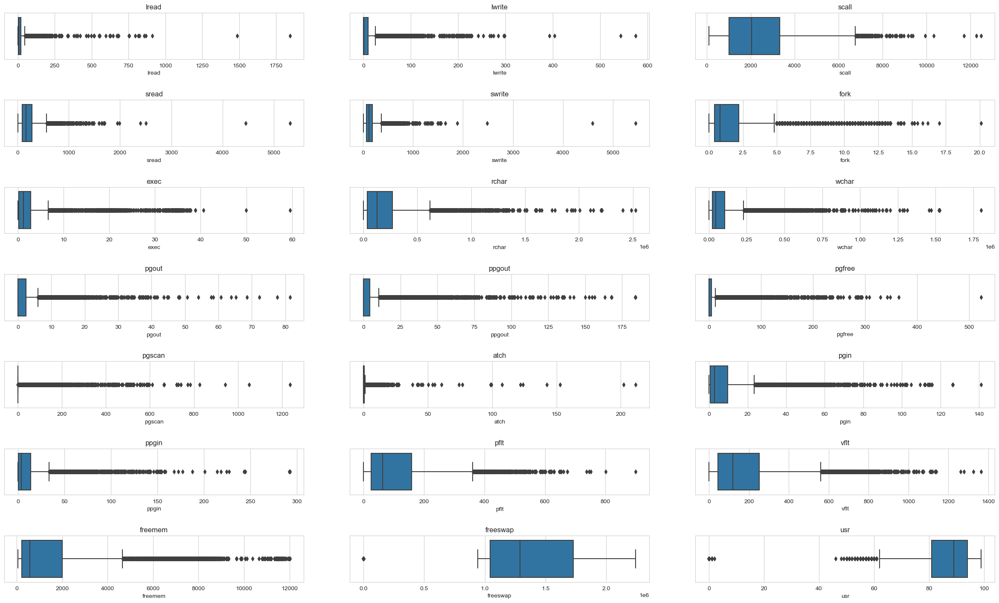

In [239]:
fig, ax = plt.subplots(7,3)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=comp_df,x='lread',ax=ax[0][0]).set(title='lread')
sns.boxplot(data=comp_df,x='lwrite',ax=ax[0][1]).set(title='lwrite')
sns.boxplot(data=comp_df,x='scall',ax=ax[0][2]).set(title='scall')
sns.boxplot(data=comp_df,x='sread',ax=ax[1][0]).set(title='sread')
sns.boxplot(data=comp_df,x='swrite',ax=ax[1][1]).set(title='swrite')
sns.boxplot(data=comp_df,x='fork',ax=ax[1][2]).set(title='fork')
sns.boxplot(data=comp_df,x='exec',ax=ax[2][0]).set(title='exec')
sns.boxplot(data=comp_df,x='rchar',ax=ax[2][1]).set(title='rchar')
sns.boxplot(data=comp_df,x='wchar',ax=ax[2][2]).set(title='wchar')
sns.boxplot(data=comp_df,x='pgout',ax=ax[3][0]).set(title='pgout')
sns.boxplot(data=comp_df,x='ppgout',ax=ax[3][1]).set(title='ppgout')
sns.boxplot(data=comp_df,x='pgfree',ax=ax[3][2]).set(title='pgfree')
sns.boxplot(data=comp_df,x='pgscan',ax=ax[4][0]).set(title='pgscan')
sns.boxplot(data=comp_df,x='atch',ax=ax[4][1]).set(title='atch')
sns.boxplot(data=comp_df,x='pgin',ax=ax[4][2]).set(title='pgin')
sns.boxplot(data=comp_df,x='ppgin',ax=ax[5][0]).set(title='ppgin')
sns.boxplot(data=comp_df,x='pflt',ax=ax[5][1]).set(title='pflt')
sns.boxplot(data=comp_df,x='vflt',ax=ax[5][2]).set(title='vflt')
sns.boxplot(data=comp_df,x='freemem',ax=ax[6][0]).set(title='freemem')
sns.boxplot(data=comp_df,x='freeswap',ax=ax[6][1]).set(title='freeswap')
sns.boxplot(data=comp_df,x='usr',ax=ax[6][2]).set(title='usr')

## Bivariate Analysis

A bivariate analysis among the different variables can be done using scatter matrix plot. Seaborn libs create a dashboard reflecting useful information about the dimensions. The result can be stored as a .png file.

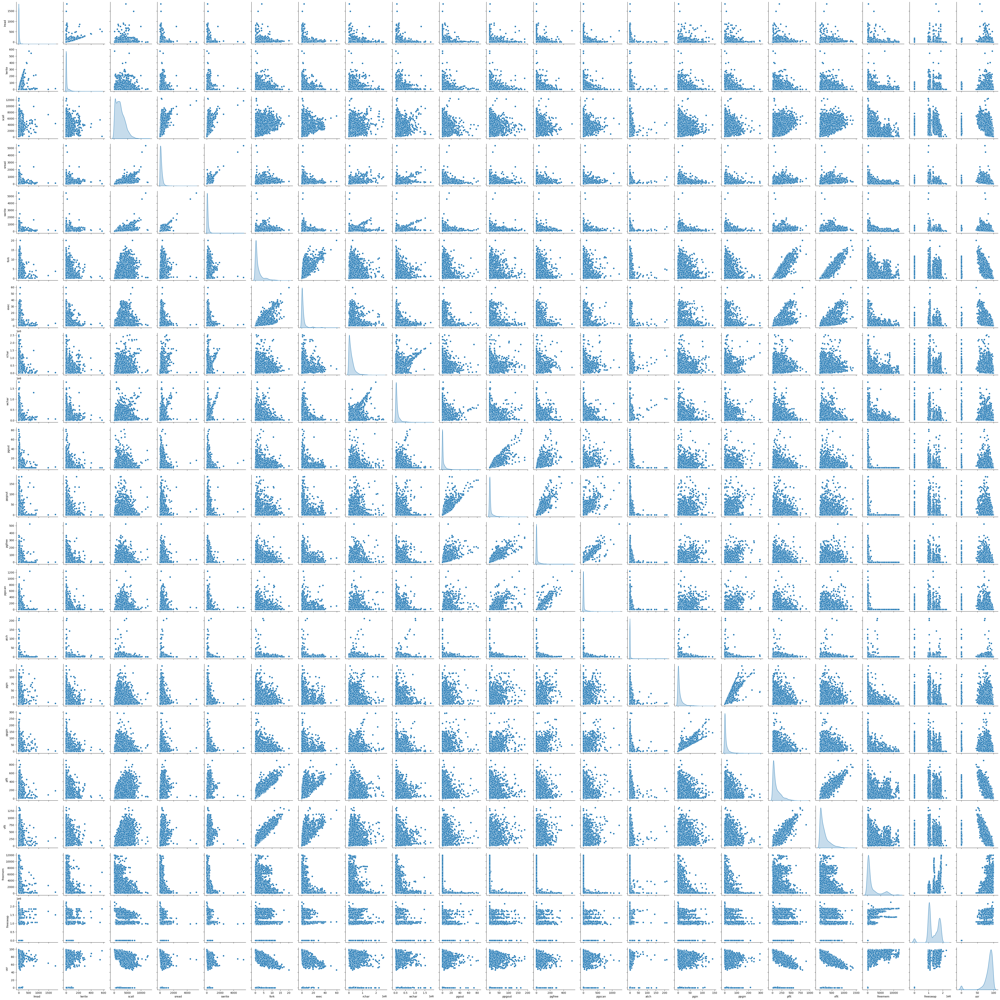

In [17]:
comp_df_numerical = comp_df.select_dtypes(include=['int64','float64'])
sns.pairplot(comp_df_numerical,diag_kind = 'kde')
# to plot density curve instead of histogram on the diag

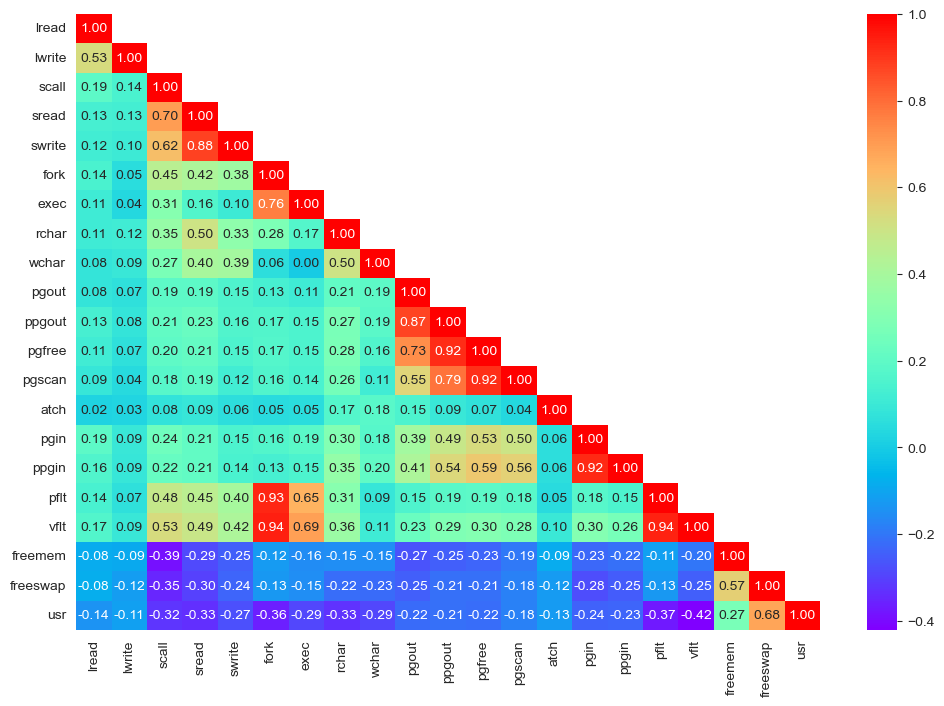

In [240]:
plt.figure(figsize=(12,8))
sns.heatmap(comp_df.corr(),annot=True,fmt='.2f',cmap='rainbow',mask=np.triu(comp_df.corr(),+1))
plt.show()


<AxesSubplot:xlabel='runqsz', ylabel='usr'>

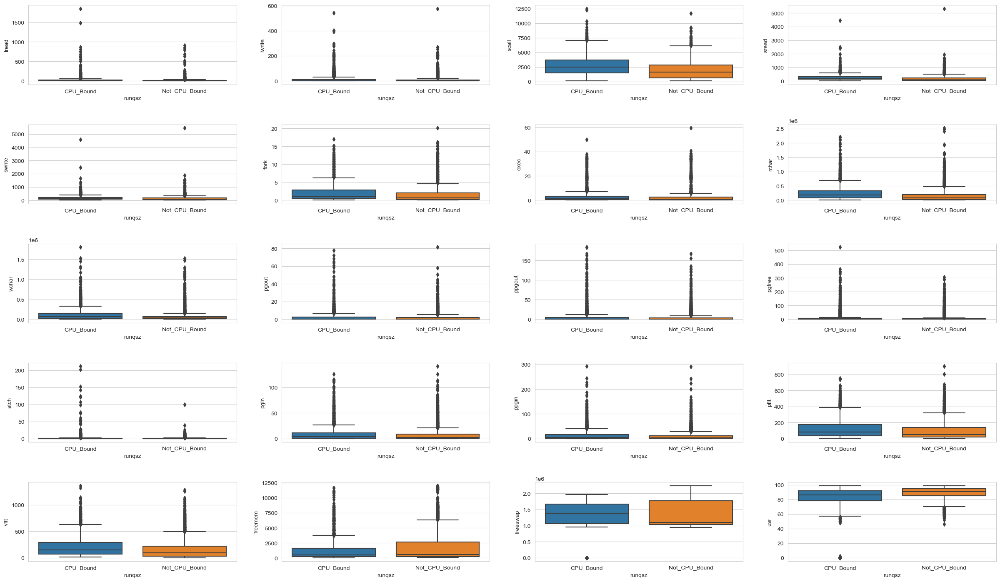

In [245]:
fig, ax = plt.subplots(5,4)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=comp_df,y='lread',x='runqsz',ax=ax[0][0])
sns.boxplot(data=comp_df,y='lwrite',x='runqsz',ax=ax[0][1])
sns.boxplot(data=comp_df,y='scall',x='runqsz',ax=ax[0][2])
sns.boxplot(data=comp_df,y='sread',x='runqsz',ax=ax[0][3])
sns.boxplot(data=comp_df,y='swrite',x='runqsz',ax=ax[1][0])
sns.boxplot(data=comp_df,y='fork',x='runqsz',ax=ax[1][1])
sns.boxplot(data=comp_df,y='exec',x='runqsz',ax=ax[1][2])
sns.boxplot(data=comp_df,y='rchar',x='runqsz',ax=ax[1][3])
sns.boxplot(data=comp_df,y='wchar',x='runqsz',ax=ax[2][0])
sns.boxplot(data=comp_df,y='pgout',x='runqsz',ax=ax[2][1])
sns.boxplot(data=comp_df,y='ppgout',x='runqsz',ax=ax[2][2])
sns.boxplot(data=comp_df,y='pgfree',x='runqsz',ax=ax[2][3])
sns.boxplot(data=comp_df,y='atch',x='runqsz',ax=ax[3][0])
sns.boxplot(data=comp_df,y='pgin',x='runqsz',ax=ax[3][1])
sns.boxplot(data=comp_df,y='ppgin',x='runqsz',ax=ax[3][2])
sns.boxplot(data=comp_df,y='pflt',x='runqsz',ax=ax[3][3])
sns.boxplot(data=comp_df,y='vflt',x='runqsz',ax=ax[4][0])
sns.boxplot(data=comp_df,y='freemem',x='runqsz',ax=ax[4][1])
sns.boxplot(data=comp_df,y='freeswap',x='runqsz',ax=ax[4][2])
sns.boxplot(data=comp_df,y='usr',x='runqsz',ax=ax[4][3])

In [249]:
comp_df.groupby('runqsz')['usr'].mean()

runqsz
CPU_Bound        78.863248
Not_CPU_Bound    88.520434
Name: usr, dtype: float64

In [251]:
comp_df.groupby('runqsz')['scall'].mean()

runqsz
CPU_Bound        2729.892256
Not_CPU_Bound    1928.710459
Name: scall, dtype: float64

In [250]:
comp_df.groupby('runqsz')['freeswap'].mean()

runqsz
CPU_Bound        1.298498e+06
Not_CPU_Bound    1.354539e+06
Name: freeswap, dtype: float64

In [253]:
comp_df.groupby('runqsz')['wchar'].mean()

runqsz
CPU_Bound        120430.884216
Not_CPU_Bound     74057.573642
Name: wchar, dtype: float64

In [254]:
comp_df.groupby('runqsz')['rchar'].mean()

runqsz
CPU_Bound        246715.991872
Not_CPU_Bound    153364.758540
Name: rchar, dtype: float64

In [255]:
comp_df.groupby('runqsz')['freemem'].mean()

runqsz
CPU_Bound        1330.993525
Not_CPU_Bound    2148.988224
Name: freemem, dtype: float64

In [256]:
comp_df.groupby('runqsz')['pflt'].mean()

runqsz
CPU_Bound        123.798879
Not_CPU_Bound     97.308550
Name: pflt, dtype: float64

Multivariate Analsis

<AxesSubplot:xlabel='fork', ylabel='exec'>

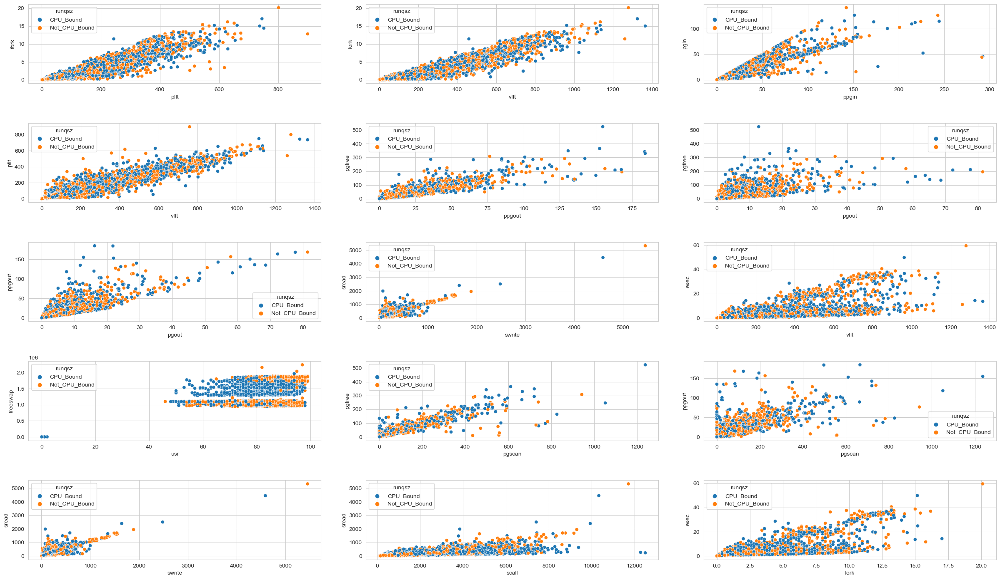

In [261]:
fig, ax = plt.subplots(5,3)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.scatterplot(data=comp_df,y='fork',x='pflt',hue='runqsz',ax=ax[0][0])
sns.scatterplot(data=comp_df,y='fork',x='vflt',hue='runqsz',ax=ax[0][1])
sns.scatterplot(data=comp_df,y='pgin',x='ppgin',hue='runqsz',ax=ax[0][2])
sns.scatterplot(data=comp_df,y='pflt',x='vflt',hue='runqsz',ax=ax[1][0])
sns.scatterplot(data=comp_df,y='pgfree',x='ppgout',hue='runqsz',ax=ax[1][1])
sns.scatterplot(data=comp_df,y='pgfree',x='pgout',hue='runqsz',ax=ax[1][2])
sns.scatterplot(data=comp_df,y='ppgout',x='pgout',hue='runqsz',ax=ax[2][0])
sns.scatterplot(data=comp_df,y='sread',x='swrite',hue='runqsz',ax=ax[2][1])
sns.scatterplot(data=comp_df,y='exec',x='vflt',hue='runqsz',ax=ax[2][2])
sns.scatterplot(data=comp_df,y='freeswap',x='usr',hue='runqsz',ax=ax[3][0])
sns.scatterplot(data=comp_df,y='pgfree',x='pgscan',hue='runqsz',ax=ax[3][1])
sns.scatterplot(data=comp_df,y='ppgout',x='pgscan',hue='runqsz',ax=ax[3][2])
sns.scatterplot(data=comp_df,y='sread',x='swrite',hue='runqsz',ax=ax[4][0])
sns.scatterplot(data=comp_df,y='sread',x='scall',hue='runqsz',ax=ax[4][1])
sns.scatterplot(data=comp_df,y='exec',x='fork',hue='runqsz',ax=ax[4][2])

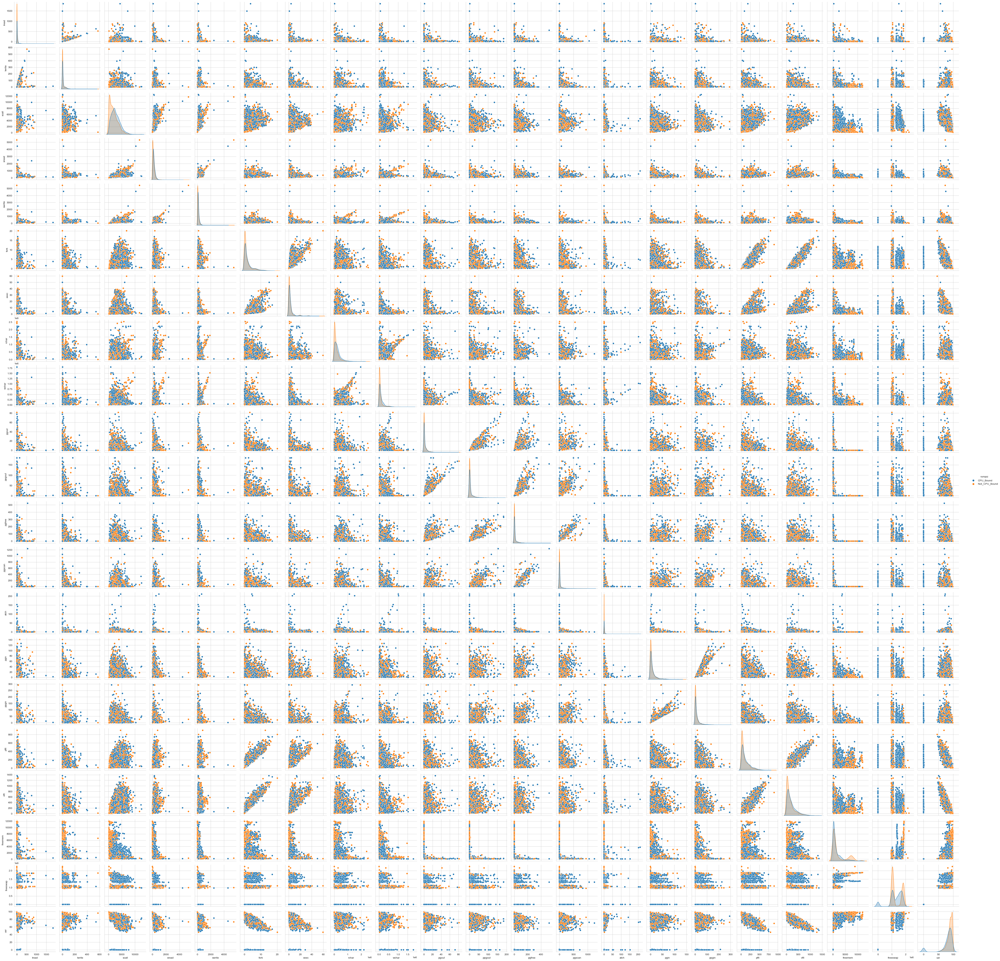

In [265]:
sns.pairplot(comp_df,hue='runqsz',diag_kind = 'kde')
# to plot density curve instead of histogram on the diag

<AxesSubplot:>

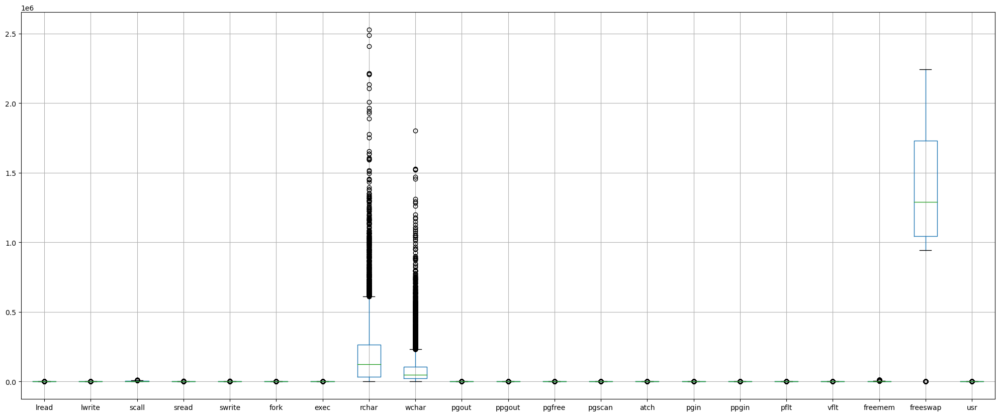

In [19]:
plt.figure(figsize=(25,10))
comp_df_numerical.boxplot()

In [20]:
comp_df.describe()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr
count,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8.192000e+03,8.192000e+03,8192.000000,...,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8.192000e+03,8192.000000
mean,19.559692,13.106201,2306.318237,210.479980,150.058228,1.884554,2.791998,1.964728e+05,9.581275e+04,2.285317,...,11.919712,21.526849,1.127505,8.277960,12.388586,109.793799,185.315796,1763.456299,1.328126e+06,83.968872
std,53.353799,29.891726,1633.617322,198.980146,160.478980,2.479493,5.212456,2.384460e+05,1.407285e+05,5.307038,...,32.363520,71.141340,5.708347,13.874978,22.281318,114.419221,191.000603,2482.104511,4.220194e+05,18.401905
min,0.000000,0.000000,109.000000,6.000000,7.000000,0.000000,0.000000,2.780000e+02,1.498000e+03,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.200000,55.000000,2.000000e+00,0.000000
25%,2.000000,0.000000,1012.000000,86.000000,63.000000,0.400000,0.200000,3.486050e+04,2.297775e+04,0.000000,...,0.000000,0.000000,0.000000,0.600000,0.600000,25.000000,45.400000,231.000000,1.042624e+06,81.000000
50%,7.000000,1.000000,2051.500000,166.000000,117.000000,0.800000,1.200000,1.254735e+05,4.661900e+04,0.000000,...,0.000000,0.000000,0.000000,2.800000,3.800000,63.800000,120.400000,579.000000,1.289290e+06,89.000000
75%,20.000000,10.000000,3317.250000,279.000000,185.000000,2.200000,2.800000,2.653948e+05,1.060370e+05,2.400000,...,5.000000,0.000000,0.600000,9.765000,13.800000,159.600000,251.800000,2002.250000,1.730380e+06,94.000000
max,1845.000000,575.000000,12493.000000,5318.000000,5456.000000,20.120000,59.560000,2.526649e+06,1.801623e+06,81.440000,...,523.000000,1237.000000,211.580000,141.200000,292.610000,899.800000,1365.000000,12027.000000,2.243187e+06,99.000000


## Create Dummy Variables

Values like 'runqsz' cannot be read into an equation. Using substitutes like 1 for Not_CPU_Bound, 0 for CPU_Bound .
So we create 2 simple true or false columns with titles equivalent to "Is this CPU_Bound?", "Is this Not_CPU_Bound?". These will be used as independent variables without imposing any kind of ordering between the two values of ruqsz.
We can also dropping one of those 2 columns to ensure there is no linear dependency between the 2 columns.

In [298]:
for feature in comp_df.columns: 
    if comp_df[feature].dtype == 'object': 
        comp_df[feature] = pd.Categorical(comp_df[feature]).codes

In [22]:
comp_df['runqsz'].value_counts()

1    4331
0    3861
Name: runqsz, dtype: int64

## Dealing with Missing Values

In [299]:
comp_df['wchar']=comp_df['wchar'].fillna(comp_df['wchar'].median())

In [300]:
comp_df['rchar']=comp_df['rchar'].fillna(comp_df['rchar'].median())

In [ ]:
comp_df.isnull().sum()

In [ ]:
comp_df.describe().T

### Without Treating the outliers lets see the performance of the Model

In [182]:
# independent variables
X = comp_df.drop(["usr"], axis=1)
# dependent variable
y = comp_df[["usr"]]

In [183]:
X = sm.add_constant(X)

In [184]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=1
)

In [185]:
olsmod = sm.OLS(y_train, X_train)
olsres = olsmod.fit()

In [186]:
# let's print the regression summary
print(olsres.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.643
Model:                            OLS   Adj. R-squared:                  0.642
Method:                 Least Squares   F-statistic:                     489.6
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        13:52:00   Log-Likelihood:                -21788.
No. Observations:                5734   AIC:                         4.362e+04
Df Residuals:                    5712   BIC:                         4.377e+04
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.6380      0.746     59.831      0.0

### Lets see the performance of the model after treating Outliers 

In [301]:
def treat_outlier(x):
    # taking 25,75 percentile of column
    q25=np.percentile(x,25)
    q75=np.percentile(x,75)
    #calculationg IQR range
    IQR=q75-q25
    #Calculating minimum threshold
    lower_bound=q25-(1.5*IQR)
    upper_bound=q75+(1.5*IQR)
    #Capping outliers
    return x.apply(lambda y: upper_bound if y > upper_bound else y).apply(lambda y: lower_bound if y < lower_bound else y)

In [302]:
outlier_list=['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin', 'ppgin',
       'pflt', 'vflt', 'freemem', 'freeswap', 'usr']

In [303]:
for i in comp_df[outlier_list]:    
    comp_df[i]=treat_outlier(comp_df[i])

[Text(0.5, 1.0, 'usr')]

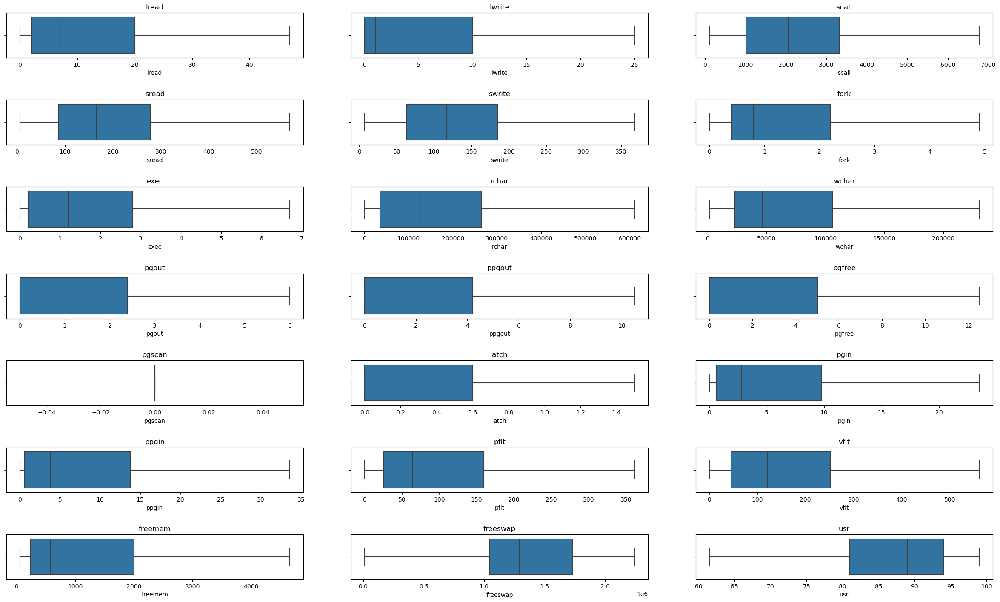

In [31]:
fig, ax = plt.subplots(7,3)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=comp_df,x='lread',ax=ax[0][0]).set(title='lread')
sns.boxplot(data=comp_df,x='lwrite',ax=ax[0][1]).set(title='lwrite')
sns.boxplot(data=comp_df,x='scall',ax=ax[0][2]).set(title='scall')
sns.boxplot(data=comp_df,x='sread',ax=ax[1][0]).set(title='sread')
sns.boxplot(data=comp_df,x='swrite',ax=ax[1][1]).set(title='swrite')
sns.boxplot(data=comp_df,x='fork',ax=ax[1][2]).set(title='fork')
sns.boxplot(data=comp_df,x='exec',ax=ax[2][0]).set(title='exec')
sns.boxplot(data=comp_df,x='rchar',ax=ax[2][1]).set(title='rchar')
sns.boxplot(data=comp_df,x='wchar',ax=ax[2][2]).set(title='wchar')
sns.boxplot(data=comp_df,x='pgout',ax=ax[3][0]).set(title='pgout')
sns.boxplot(data=comp_df,x='ppgout',ax=ax[3][1]).set(title='ppgout')
sns.boxplot(data=comp_df,x='pgfree',ax=ax[3][2]).set(title='pgfree')
sns.boxplot(data=comp_df,x='pgscan',ax=ax[4][0]).set(title='pgscan')
sns.boxplot(data=comp_df,x='atch',ax=ax[4][1]).set(title='atch')
sns.boxplot(data=comp_df,x='pgin',ax=ax[4][2]).set(title='pgin')
sns.boxplot(data=comp_df,x='ppgin',ax=ax[5][0]).set(title='ppgin')
sns.boxplot(data=comp_df,x='pflt',ax=ax[5][1]).set(title='pflt')
sns.boxplot(data=comp_df,x='vflt',ax=ax[5][2]).set(title='vflt')
sns.boxplot(data=comp_df,x='freemem',ax=ax[6][0]).set(title='freemem')
sns.boxplot(data=comp_df,x='freeswap',ax=ax[6][1]).set(title='freeswap')
sns.boxplot(data=comp_df,x='usr',ax=ax[6][2]).set(title='usr')

<AxesSubplot:>

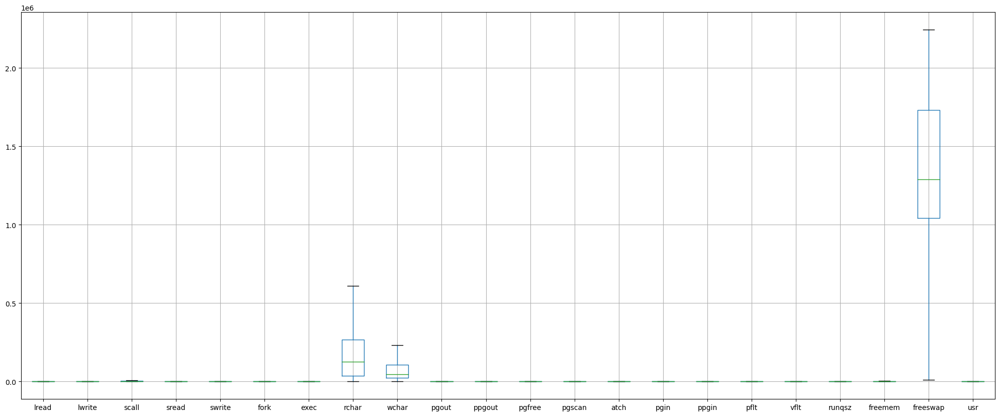

In [32]:
plt.figure(figsize=(25,10))
comp_df.boxplot()

* Observe that the relationship between 'usr' has correlation with variables pflt,vflt,fork,


In [33]:
comp_df.describe().T

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.342285e+01,15.159741,0.0,2.00,7.0,20.000,4.700000e+01
lwrite,8192.0,6.657471e+00,9.291945,0.0,0.00,1.0,10.000,2.500000e+01
scall,8192.0,2.294484e+03,1593.093446,109.0,1012.00,2051.5,3317.250,6.775125e+03
sread,8192.0,1.997764e+02,146.758932,6.0,86.00,166.0,279.000,5.685000e+02
swrite,8192.0,1.379700e+02,97.141835,7.0,63.00,117.0,185.000,3.680000e+02
fork,8192.0,1.557771e+00,1.591220,0.0,0.40,0.8,2.200,4.900000e+00
exec,8192.0,1.931495e+00,2.028253,0.0,0.20,1.2,2.800,6.700000e+00
rchar,8192.0,1.788841e+05,174589.212910,278.0,34860.50,125473.5,265394.750,6.111961e+05
wchar,8192.0,7.564554e+04,71262.958027,1498.0,22977.75,46619.0,106037.000,2.306259e+05
pgout,8192.0,1.420901e+00,2.200251,0.0,0.00,0.0,2.400,6.000000e+00


pgscan variable is 0 after treating the ouliers so we can drop the variable before creating the model

In [304]:
comp_df.drop(['pgscan'], axis=1,inplace =True)

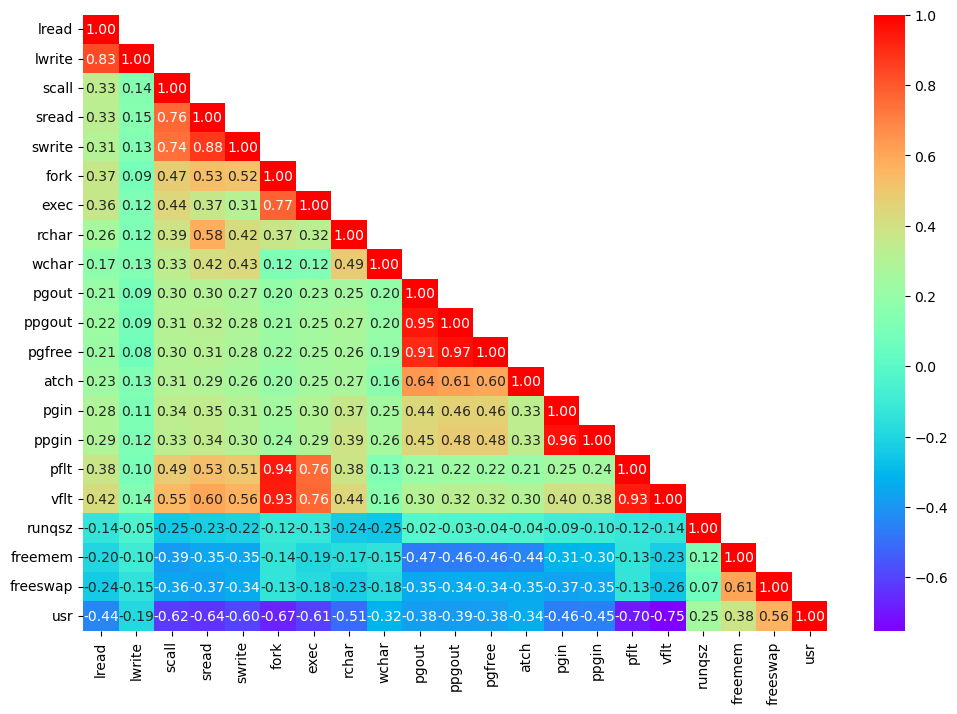

In [35]:
plt.figure(figsize=(12,8))
sns.heatmap(comp_df.corr(),annot=True,fmt='.2f',cmap='rainbow',mask=np.triu(comp_df.corr(),+1))
plt.show()

## Split Data

In [305]:
# independent variables
X = comp_df.drop(["usr"], axis=1)
# dependent variable
y = comp_df[["usr"]]

In [306]:
# let's add the intercept to data
X = sm.add_constant(X)

**We will now split X and y into train and test sets in a 70:30 ratio.**

In [307]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=1
)

In [194]:
X_train.shape

(5734, 21)

In [195]:
X_test.shape

(2458, 21)

## Fit Linear Model

In [196]:
olsmod = sm.OLS(y_train, X_train)
olsres = olsmod.fit()

In [197]:
# let's print the regression summary
print(olsres.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1115.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        13:52:38   Log-Likelihood:                -16657.
No. Observations:                5734   AIC:                         3.336e+04
Df Residuals:                    5713   BIC:                         3.350e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.1217      0.316    266.106      0.0

In [77]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       29.229332
lread        5.350560
lwrite       4.328397
scall        2.960609
sread        6.420172
swrite       5.597135
fork        13.035359
exec         3.241417
rchar        2.133616
wchar        1.584381
pgout       11.360363
ppgout      29.404223
pgfree      16.496748
atch         1.875901
pgin        13.809339
ppgin       13.951855
pflt        12.001460
vflt        15.971049
runqsz       1.156815
freemem      1.961304
freeswap     1.841239
dtype: float64



* The VIF values indicate that the features ppgout, pgfree, vflt, pflt,pgin,ppgin,fork,pgout,swrite,sread and lread are correlated with one or more independent features.

* Multicollinearity affects only the specific independent variables that are correlated. Therefore, in this case, we can trust the p-values of ppgout, pgfree, vflt, pflt,pgin,ppgin,fork,pgout,swrite,sread and lread.

* To treat multicollinearity, we will have to drop one or more of the correlated features ().

* We will drop the variable that has the least impact on the adjusted R-squared of the model.

#### Let's remove/drop multicollinear columns one by one and observe the effect on our predictive model.

In [44]:
X_train1 = X_train.drop(["ppgout"], axis=1)
olsmod_1 = sm.OLS(y_train, X_train1)
olsres_1 = olsmod_1.fit()
print(
    "R-squared:",
    np.round(olsres_1.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_1.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


* On dropping 'ppgout', adj. R-squared has not changed

In [45]:
X_train2 = X_train.drop(["pgfree"], axis=1)
olsmod_2 = sm.OLS(y_train, X_train2)
olsres_2 = olsmod_2.fit()
print(
    "R-squared:",
    np.round(olsres_2.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_2.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


* On dropping 'pgfree', adj. R-squared has not changed


In [46]:
X_train3 = X_train.drop(["vflt"], axis=1)
olsmod_3 = sm.OLS(y_train, X_train3)
olsres_3 = olsmod_3.fit()
print(
    "R-squared:",
    np.round(olsres_3.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_3.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


* On dropping 'fork', adj. R-squared decreased by 0.054
* This sharp decline indicates that 'weight' is an important predictor and shouldn't be removed.


In [47]:
X_train4 = X_train.drop(["ppgin"], axis=1)
olsmod_4 = sm.OLS(y_train, X_train4)
olsres_4 = olsmod_4.fit()
print(
    "R-squared:",
    np.round(olsres_4.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_4.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


In [48]:
X_train5 = X_train.drop(["pgin"], axis=1)
olsmod_5 = sm.OLS(y_train, X_train5)
olsres_5 = olsmod_5.fit()
print(
    "R-squared:",
    np.round(olsres_5.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_5.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


In [49]:
X_train7 = X_train.drop(["fork"], axis=1)
olsmod_7 = sm.OLS(y_train, X_train7)
olsres_7 = olsmod_7.fit()
print(
    "R-squared:",
    np.round(olsres_7.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_7.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


In [50]:
X_train8 = X_train.drop(["pflt"], axis=1)
olsmod_8 = sm.OLS(y_train, X_train8)
olsres_8 = olsmod_8.fit()
print(
    "R-squared:",
    np.round(olsres_8.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_8.rsquared_adj, 3),
)

R-squared: 0.786 
Adjusted R-squared: 0.785


In [51]:
X_train9 = X_train.drop(["pgout"], axis=1)
olsmod_9 = sm.OLS(y_train, X_train9)
olsres_9 = olsmod_9.fit()
print(
    "R-squared:",
    np.round(olsres_9.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_9.rsquared_adj, 3),
)

R-squared: 0.796 
Adjusted R-squared: 0.795


**Since there is no effect on adj. R-squared after dropping the 'ppgout' column, we can remove it from the training set.**

### Final

In [308]:
X_train = X_train.drop(['ppgout'], axis=1)

In [309]:
X_test = X_test.drop(['ppgout'], axis=1)

In [310]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1174.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:33:34   Log-Likelihood:                -16658.
No. Observations:                5734   AIC:                         3.336e+04
Df Residuals:                    5714   BIC:                         3.349e+04
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.1477      0.315    267.138      0.0

### Let's check if multicollinearity is still present in the data.


In [54]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       29.021961
lread        5.350387
lwrite       4.328325
scall        2.960379
sread        6.420135
swrite       5.597025
fork        13.027305
exec         3.239231
rchar        2.133614
wchar        1.580894
pgout        6.453978
pgfree       6.172847
atch         1.875553
pgin        13.784007
ppgin       13.898848
pflt        12.001460
vflt        15.966865
runqsz       1.156421
freemem      1.959267
freeswap     1.838167
dtype: float64



In [311]:
X_train = X_train.drop(['vflt'], axis=1)

In [312]:
X_test = X_test.drop(['vflt'], axis=1)

In [313]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1235.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:33:43   Log-Likelihood:                -16665.
No. Observations:                5734   AIC:                         3.337e+04
Df Residuals:                    5715   BIC:                         3.349e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.0090      0.313    268.139      0.0

In [57]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.641818
lread        5.335455
lwrite       4.327130
scall        2.952947
sread        6.374687
swrite       5.595777
fork        10.089700
exec         3.235396
rchar        2.123783
wchar        1.558923
pgout        6.450724
pgfree       6.149223
atch         1.864254
pgin        13.602134
ppgin       13.898845
pflt         9.131802
runqsz       1.156363
freemem      1.957966
freeswap     1.787695
dtype: float64



In [314]:
X_train = X_train.drop(['ppgin'], axis=1)

In [315]:
X_test = X_test.drop(['ppgin'], axis=1)

In [316]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1305.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:33:50   Log-Likelihood:                -16671.
No. Observations:                5734   AIC:                         3.338e+04
Df Residuals:                    5716   BIC:                         3.350e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.0531      0.313    268.240      0.0

In [60]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.594882
lread        5.304009
lwrite       4.316362
scall        2.951826
sread        6.374556
swrite       5.595670
fork        10.074886
exec         3.235387
rchar        2.090401
wchar        1.558921
pgout        6.445478
pgfree       6.093623
atch         1.863536
pgin         1.529142
pflt         9.131545
runqsz       1.155990
freemem      1.957713
freeswap     1.785393
dtype: float64



In [317]:
X_train = X_train.drop(['fork'], axis=1)

In [318]:
X_test = X_test.drop(['fork'], axis=1)

In [319]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     1386.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:33:59   Log-Likelihood:                -16672.
No. Observations:                5734   AIC:                         3.338e+04
Df Residuals:                    5717   BIC:                         3.349e+04
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.0913      0.313    269.048      0.0

In [63]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.440419
lread        5.285069
lwrite       4.298019
scall        2.914853
sread        6.373458
swrite       5.390263
exec         2.856973
rchar        2.089364
wchar        1.550686
pgout        6.445377
pgfree       6.093041
atch         1.862553
pgin         1.526800
pflt         3.458168
runqsz       1.155448
freemem      1.957226
freeswap     1.782829
dtype: float64



In [64]:
X_train22 = X_train.drop(['pgout'], axis=1)
olsmod_22 = sm.OLS(y_train, X_train22)
olsres_22 = olsmod_22.fit()
print(
    "R-squared:",
    np.round(olsres_22.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_22.rsquared_adj, 3),
)

R-squared: 0.794 
Adjusted R-squared: 0.793


In [65]:
X_train23 = X_train.drop(['pgfree'], axis=1)
olsmod_23 = sm.OLS(y_train, X_train23)
olsres_23 = olsmod_23.fit()
print(
    "R-squared:",
    np.round(olsres_23.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_23.rsquared_adj, 3),
)

R-squared: 0.795 
Adjusted R-squared: 0.794


In [66]:
X_train24 = X_train.drop(['sread'], axis=1)
olsmod_24 = sm.OLS(y_train, X_train24)
olsres_24 = olsmod_24.fit()
print(
    "R-squared:",
    np.round(olsres_24.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_24.rsquared_adj, 3),
)

R-squared: 0.795 
Adjusted R-squared: 0.794


In [320]:
X_train = X_train.drop(['pgfree'], axis=1)

In [321]:
X_test = X_test.drop(['pgfree'], axis=1)

In [322]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     1478.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:34:07   Log-Likelihood:                -16673.
No. Observations:                5734   AIC:                         3.338e+04
Df Residuals:                    5718   BIC:                         3.348e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.0915      0.313    269.046      0.0

In [69]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.440413
lread        5.279884
lwrite       4.292116
scall        2.910969
sread        6.372750
swrite       5.389795
exec         2.854013
rchar        2.089028
wchar        1.550381
pgout        2.031561
atch         1.861498
pgin         1.498879
pflt         3.458070
runqsz       1.155222
freemem      1.946405
freeswap     1.781403
dtype: float64



In [70]:
X_train26 = X_train.drop(['sread'], axis=1)
olsmod_26 = sm.OLS(y_train, X_train26)
olsres_26 = olsmod_26.fit()
print(
    "R-squared:",
    np.round(olsres_26.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_26.rsquared_adj, 3),
)

R-squared: 0.795 
Adjusted R-squared: 0.794


In [71]:
X_train27 = X_train.drop(['lread'], axis=1)
olsmod_27 = sm.OLS(y_train, X_train27)
olsres_27 = olsmod_27.fit()
print(
    "R-squared:",
    np.round(olsres_27.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_27.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [72]:
X_train28 = X_train.drop(['swrite'], axis=1)
olsmod_28 = sm.OLS(y_train, X_train28)
olsres_28 = olsmod_28.fit()
print(
    "R-squared:",
    np.round(olsres_28.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_28.rsquared_adj, 3),
)

R-squared: 0.794 
Adjusted R-squared: 0.794


In [323]:
X_train = X_train.drop(['sread'], axis=1)

In [324]:
X_test = X_test.drop(['sread'], axis=1)

In [325]:
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     1584.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:34:17   Log-Likelihood:                -16673.
No. Observations:                5734   AIC:                         3.338e+04
Df Residuals:                    5719   BIC:                         3.348e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.0919      0.312    269.420      0.0

In [216]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.366778
lread        5.272488
lwrite       4.282984
scall        2.653943
swrite       3.012451
exec         2.847353
rchar        1.672481
wchar        1.537067
pgout        2.029172
atch         1.860242
pgin         1.497984
pflt         3.436202
runqsz       1.155214
freemem      1.945888
freeswap     1.767780
dtype: float64



In [76]:
X_train29 = X_train.drop(['lread'], axis=1)
olsmod_29 = sm.OLS(y_train, X_train29)
olsres_29 = olsmod_29.fit()
print(
    "R-squared:",
    np.round(olsres_29.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(olsres_29.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [326]:
X_train = X_train.drop(['lread'], axis=1)
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1684.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:34:23   Log-Likelihood:                -16702.
No. Observations:                5734   AIC:                         3.343e+04
Df Residuals:                    5720   BIC:                         3.353e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         83.9943      0.313    267.987      0.0

In [327]:
X_test = X_test.drop(['lread'], axis=1)

In [78]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const       28.319429
lwrite       1.051857
scall        2.647850
swrite       3.011789
exec         2.819082
rchar        1.672367
wchar        1.533942
pgout        2.029125
atch         1.859694
pgin         1.454496
pflt         3.254499
runqsz       1.144436
freemem      1.945632
freeswap     1.761784
dtype: float64



### Actual Vs Fitted Values

In [328]:
comp_df_pred = pd.DataFrame()

comp_df_pred["Actual Values"] = y_train.values.flatten()  # actual values
comp_df_pred["Fitted Values"] = model.fittedvalues.values  # predicted values
comp_df_pred["Residuals"] = model.resid.values  # residuals

comp_df_pred.head(10)

,Actual Values,Fitted Values,Residuals
0,91.0,90.985214,0.014786
1,94.0,91.740525,2.259475
2,61.5,75.127299,-13.627299
3,83.0,80.546759,2.453241
4,94.0,97.487993,-3.487993
5,98.0,98.459931,-0.459931
6,79.0,77.912998,1.087002
7,87.0,96.898262,-9.898262
8,83.0,82.399996,0.600004
9,82.0,82.390489,-0.390489


In [329]:
y_pred_test = model.predict(X_test)



In [330]:
y_pred_train = model.predict(X_train)

In [331]:
rmse1 = np.sqrt(mean_squared_error(y_train, y_pred_train))
rmse1

4.454425641530248

In [332]:
# let's check the RMSE on the test data
rmse2 = np.sqrt(mean_squared_error(y_test, y_pred_test))
rmse2

4.685030644798209

### LinearRegression()

In [224]:
regression_model = LinearRegression()
regression_model.fit(X_train, y_train)

LinearRegression()

In [231]:
regression_model.coef_

array([[ 0.00000000e+00, -3.46889626e-02, -6.84284933e-04,
        -5.90400968e-03, -3.93739910e-01, -5.53869915e-06,
        -4.52028012e-06, -3.55438941e-01,  5.86736602e-01,
        -9.41991882e-02, -4.15002249e-02,  1.68860569e+00,
        -4.67934469e-04,  8.99842542e-06]])

In [225]:
for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, regression_model.coef_[0][idx]))

The coefficient for const is 0.0
The coefficient for lwrite is -0.03468896257897594
The coefficient for scall is -0.0006842849332436193
The coefficient for swrite is -0.005904009677276247
The coefficient for exec is -0.39373991015642895
The coefficient for rchar is -5.538699146606803e-06
The coefficient for wchar is -4.520280122845764e-06
The coefficient for pgout is -0.355438940942057
The coefficient for atch is 0.5867366021279309
The coefficient for pgin is -0.09419918823789823
The coefficient for pflt is -0.041500224932719106
The coefficient for runqsz is 1.6886056874994104
The coefficient for freemem is -0.00046793446897557846
The coefficient for freeswap is 8.998425417652394e-06


In [226]:
intercept = regression_model.intercept_[0]

print("The intercept for our model is {}".format(intercept))

The intercept for our model is 83.99432279719366


In [227]:
# R square on training data
regression_model.score(X_train, y_train)

0.7928767063811195

In [228]:
# R square on testing data
regression_model.score(X_test, y_test)

0.7644517444502072

In [229]:
#RMSE on Training data

predicted_train=regression_model.fit(X_train, y_train).predict(X_train)
np.sqrt(metrics.mean_squared_error(y_train,predicted_train))

4.454425641530247

In [230]:
#RMSE on Testing data
predicted_test=regression_model.fit(X_train, y_train).predict(X_test)
np.sqrt(metrics.mean_squared_error(y_test,predicted_test))

4.685030644797855

In [88]:
print("The Root Mean Square Error (RMSE) of the model is for testing set is",np.sqrt(mean_squared_error(y_test,regression_model.predict(X_test))))

The Root Mean Square Error (RMSE) of the model is for testing set is 4.685030644797855


In [89]:
print("The Root Mean Square Error (RMSE) of the model is for training set is",np.sqrt(mean_squared_error(y_train,regression_model.predict(X_train))))

The Root Mean Square Error (RMSE) of the model is for training set is 4.454425641530247


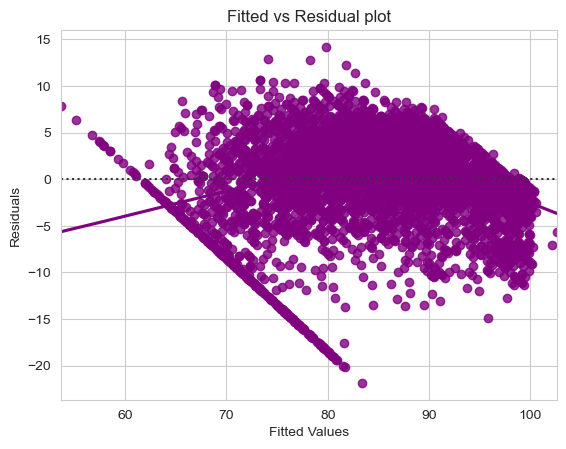

In [90]:
# let us plot the fitted values vs residuals
sns.set_style("whitegrid")
sns.residplot(
    data=comp_df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

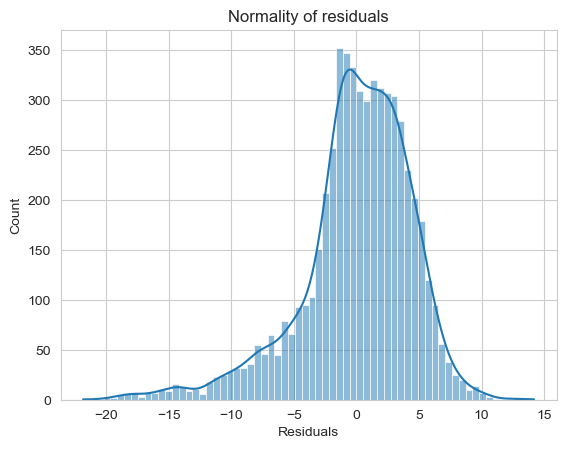

In [91]:
sns.histplot(comp_df_pred["Residuals"], kde=True)
plt.title("Normality of residuals")
plt.show()


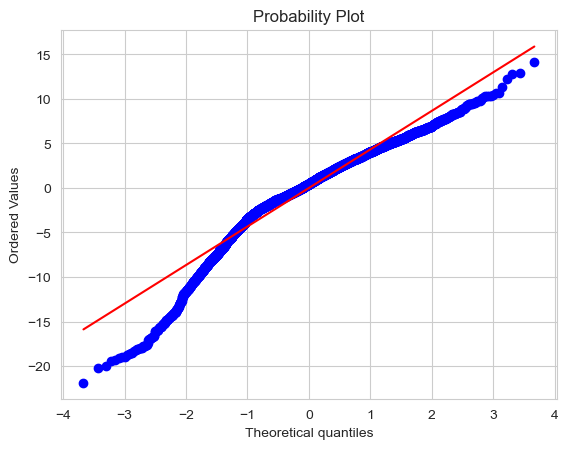

In [161]:
import pylab
import scipy.stats as stats

stats.probplot(comp_df_pred["Residuals"], dist="norm", plot=pylab)
plt.show()


The Shapiro-Wilk test can also be used for checking the normality. The null and alternate hypotheses of the test are as follows:

Null hypothesis - Data is normally distributed.
Alternate hypothesis - Data is not normally distributed.
sta

In [93]:
stats.shapiro(comp_df_pred["Residuals"])


C:\Users\Dell\anaconda3\lib\site-packages\scipy\stats\_morestats.py:1800: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9425298571586609, pvalue=1.4881789691129557e-42)

Heteroscedasticity

The null and alternate hypotheses of the goldfeldquandt test are as follows:

Null hypothesis : Residuals are homoscedastic
Alternate hypothesis : Residuals have hetroscedasticity


In [94]:
import statsmodels.stats.api as sms
from statsmodels.compat import lzip


In [95]:
name = ["F statistic", "p-value"]
test = sms.het_goldfeldquandt(comp_df_pred["Residuals"], X_train)
lzip(name, test)


[('F statistic', 1.1138123553995614), ('p-value', 0.0020027008064391126)]

Since p-value < 0.05 we can say that the residuals are heteroscedastic.


In [96]:
model.params


const       83.994323
lwrite      -0.034689
scall       -0.000684
swrite      -0.005904
exec        -0.393740
rchar       -0.000006
wchar       -0.000005
pgout       -0.355439
atch         0.586737
pgin        -0.094199
pflt        -0.041500
runqsz       1.688606
freemem     -0.000468
freeswap     0.000009
dtype: float64

In [97]:
# Let us write the equation of linear regression
Equation = "usr="
print(Equation, end=" ")
for i in range(len(X_train.columns)):
    if i == 0:
        print(model.params[i], "+", end=" ")
    elif i != len(X_train.columns) - 1:
        print(
            model.params[i],
            "* (",
            X_train.columns[i],
            ")",
            "+",
            end="  ",
        )
    else:
        print(model.params[i], "* (", X_train.columns[i], ")")


usr= 83.99432279722069 + -0.03468896257901462 * ( lwrite ) +  -0.000684284933243225 * ( scall ) +  -0.005904009677282263 * ( swrite ) +  -0.39373991015657783 * ( exec ) +  -5.5386991466067535e-06 * ( rchar ) +  -4.5202801228802394e-06 * ( wchar ) +  -0.35543894094213613 * ( pgout ) +  0.5867366021283322 * ( atch ) +  -0.09419918823792178 * ( pgin ) +  -0.041500224932716524 * ( pflt ) +  1.6886056874993933 * ( runqsz ) +  -0.0004679344689752775 * ( freemem ) +  8.998425417637567e-06 * ( freeswap )


<AxesSubplot:>

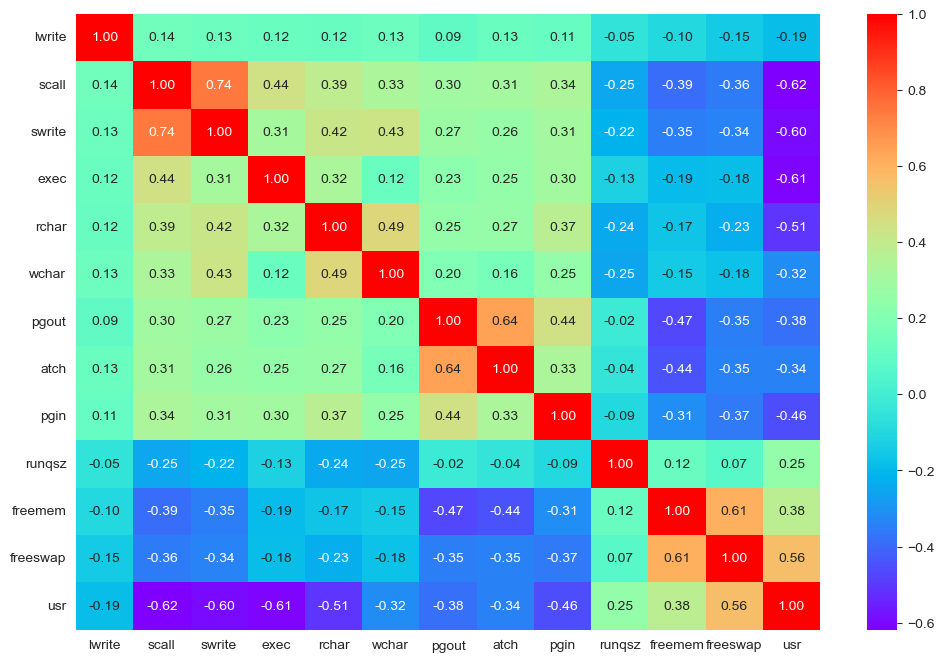

In [98]:
plt.figure(figsize=(12,8))
sns.heatmap(comp_df[["lwrite", "scall", "swrite", "exec", "rchar","wchar", "pgout", "atch", "pgin", "runqsz","freemem", "freeswap","usr"]].corr(),annot=True,fmt='.2f',cmap='rainbow')

In [333]:
X_train["freeswap_sq"] = np.square(X_train["freeswap"])
X_test["freeswap_sq"] = np.square(X_test["freeswap"])

In [334]:


# let's create a model with the transformed data
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.893
Model:                            OLS   Adj. R-squared:                  0.893
Method:                 Least Squares   F-statistic:                     3407.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:35:04   Log-Likelihood:                -14810.
No. Observations:                5734   AIC:                         2.965e+04
Df Residuals:                    5719   BIC:                         2.975e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const          74.3832      0.261    285.113      

In [104]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const           0.000000
lwrite          1.052120
scall           2.878051
swrite          3.011799
exec            2.832231
rchar           1.685903
wchar           1.534267
pgout           2.037978
atch            1.861836
pgin            1.494244
pflt            3.267691
runqsz          1.211903
freemem         2.217348
freeswap       16.452039
freeswap_sq    20.294077
dtype: float64



C:\Users\Dell\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


In [335]:
X_train["exec_squared"] = np.square(X_train["exec"])
X_test["exec_squared"] = np.square(X_test["exec"])
# let's create a model with the transformed data
model = sm.OLS(y_train, X_train)
model = model.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.897
Model:                            OLS   Adj. R-squared:                  0.897
Method:                 Least Squares   F-statistic:                     3314.
Date:                Sun, 04 Jun 2023   Prob (F-statistic):               0.00
Time:                        22:35:08   Log-Likelihood:                -14704.
No. Observations:                5734   AIC:                         2.944e+04
Df Residuals:                    5718   BIC:                         2.955e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           73.8250      0.259    285.120   

In [106]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
);
print("VIF values: \n\n{}\n".format(vif_series1));

VIF values: 

const            0.000000
lwrite           1.052243
scall            2.898477
swrite           3.064786
exec            17.615158
rchar            1.698660
wchar            1.534270
pgout            2.039459
atch             1.862230
pgin             1.494260
pflt             3.323836
runqsz           1.216081
freemem          2.220646
freeswap        16.508174
freeswap_sq     20.414215
exec_squared    13.939853
dtype: float64



C:\Users\Dell\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


In [336]:
comp_df_pred = pd.DataFrame()

comp_df_pred["Actual Values"] = y_train.values.flatten()  # actual values
comp_df_pred["Fitted Values"] = model.fittedvalues.values  # predicted values
comp_df_pred["Residuals"] = model.resid.values  # residuals

comp_df_pred.head(10)

,Actual Values,Fitted Values,Residuals
0,91.0,93.013443,-2.013443
1,94.0,94.860814,-0.860814
2,61.5,63.026092,-1.526092
3,83.0,83.326246,-0.326246
4,94.0,97.352893,-3.352893
5,98.0,96.529872,1.470128
6,79.0,79.417442,-0.417442
7,87.0,93.865664,-6.865664
8,83.0,84.849790,-1.849790
9,82.0,82.446465,-0.446465


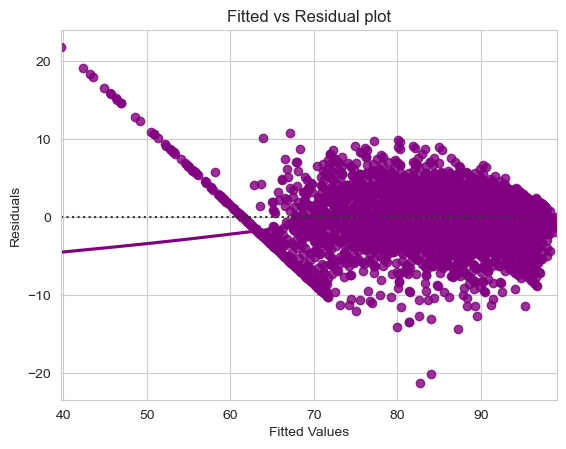

In [108]:
sns.set_style("whitegrid")
sns.residplot(
    data=comp_df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

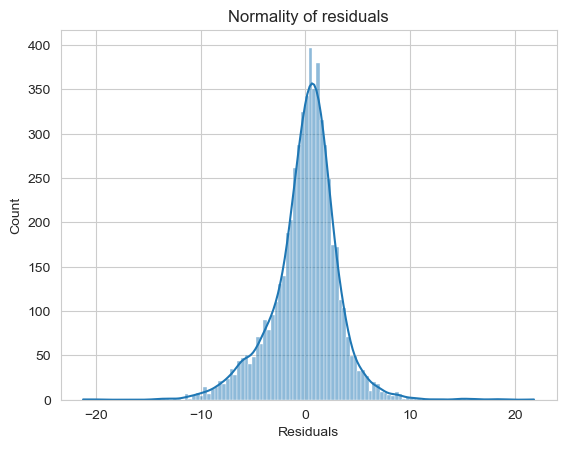

In [109]:
sns.histplot(comp_df_pred["Residuals"], kde=True)
plt.title("Normality of residuals")
plt.show()

In [166]:
stats.shapiro(comp_df_pred["Residuals"])

C:\Users\Dell\anaconda3\lib\site-packages\scipy\stats\_morestats.py:1800: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9531151056289673, pvalue=1.9972090440697315e-39)

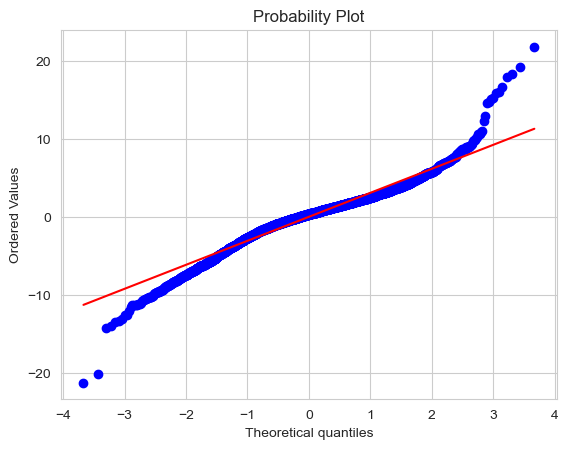

In [112]:
import pylab
import scipy.stats as stats

stats.probplot(comp_df_pred["Residuals"], dist="norm", plot=pylab)
plt.show()


In [113]:
stats.shapiro(comp_df_pred["Residuals"])

C:\Users\Dell\anaconda3\lib\site-packages\scipy\stats\_morestats.py:1800: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9531151056289673, pvalue=1.9972090440697315e-39)

In [114]:
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
name = ["F statistic", "p-value"]
test = sms.het_goldfeldquandt(comp_df_pred["Residuals"], X_train)
lzip(name, test)

[('F statistic', 1.011504202681654), ('p-value', 0.3800493352122364)]

Since p-value > 0.05 we can say that the residuals are homoscedastic.

In [337]:
y_pred_test = model.predict(X_test)


In [338]:
y_pred_train = model.predict(X_train)

In [339]:
rmse1 = np.sqrt(mean_squared_error(y_train, y_pred_train))
rmse1

3.1436527488419466

In [340]:
rmse2 = np.sqrt(mean_squared_error(y_test, y_pred_test))


In [341]:
rmse2

3.2243451386473896

In [342]:
mae1 = mean_absolute_error(y_train, comp_df_pred["Fitted Values"])
mae1

2.268917598809817

In [343]:
mae2 = mean_absolute_error(y_test,y_pred_test)
mae2

2.3170307050752936

In [122]:
model.params

const           7.382496e+01
lwrite         -3.001324e-02
scall          -1.557416e-03
swrite         -7.464151e-03
exec            5.840004e-01
rchar          -3.876321e-06
wchar          -3.753404e-06
pgout          -2.116792e-01
atch            3.095073e-01
pgin           -1.753075e-01
pflt           -3.943711e-02
runqsz          1.563800e-01
freemem         5.101357e-04
freeswap        3.707648e-05
freeswap_sq    -1.349211e-11
exec_squared   -1.681209e-01
dtype: float64

In [123]:
# Let us write the equation of linear regression
Equation = "usr="
print(Equation, end=" ")
for i in range(len(X_train.columns)):
    if i == 0:
        print(model.params[i], "+", end=" ")
    elif i != len(X_train.columns) - 1:
        print(
            model.params[i],
            "* (",
            X_train.columns[i],
            ")",
            "+",
            end="  ",
        )
    else:
        print(model.params[i], "* (", X_train.columns[i], ")")


usr= 73.8249647115637 + -0.030013244928522316 * ( lwrite ) +  -0.0015574161523834223 * ( scall ) +  -0.0074641505712279635 * ( swrite ) +  0.5840004128758598 * ( exec ) +  -3.87632110546956e-06 * ( rchar ) +  -3.7534035767923584e-06 * ( wchar ) +  -0.2116792479802895 * ( pgout ) +  0.3095072704297266 * ( atch ) +  -0.17530749139195279 * ( pgin ) +  -0.03943711343400853 * ( pflt ) +  0.15638001492770479 * ( runqsz ) +  0.0005101357337461945 * ( freemem ) +  3.707648488400133e-05 * ( freeswap ) +  -1.3492105560477411e-11 * ( freeswap_sq ) +  -0.16812091025597425 * ( exec_squared )


### LinearRegession()

In [344]:
regression_model = LinearRegression()
regression_model.fit(X_train, y_train)

LinearRegression()

In [345]:
regression_model.coef_

array([[ 0.00000000e+00, -3.00132700e-02, -1.55741591e-03,
        -7.46415433e-03,  5.84000208e-01, -3.87632151e-06,
        -3.75340223e-06, -2.11679251e-01,  3.09507354e-01,
        -1.75307617e-01, -3.94371068e-02,  1.56379482e-01,
         5.10136125e-04,  3.70764827e-05, -1.34921249e-11,
        -1.68120910e-01]])

In [346]:
for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, regression_model.coef_[0][idx]))

The coefficient for const is 0.0
The coefficient for lwrite is -0.03001327004637352
The coefficient for scall is -0.00155741591228199
The coefficient for swrite is -0.007464154330819872
The coefficient for exec is 0.5840002082414866
The coefficient for rchar is -3.8763215097133115e-06
The coefficient for wchar is -3.7534022323724933e-06
The coefficient for pgout is -0.21167925085387382
The coefficient for atch is 0.30950735432883203
The coefficient for pgin is -0.175307617273429
The coefficient for pflt is -0.03943710682097712
The coefficient for runqsz is 0.1563794824000068
The coefficient for freemem is 0.0005101361249574727
The coefficient for freeswap is 3.707648274444476e-05
The coefficient for freeswap_sq is -1.349212485622496e-11
The coefficient for exec_squared is -0.16812091026580747


In [347]:
intercept = regression_model.intercept_[0]

print("The intercept for our model is {}".format(intercept))

The intercept for our model is 73.82497875273377


In [348]:
regression_model.score(X_train, y_train)

0.8968392119448401

In [349]:
regression_model.score(X_test, y_test)


0.8884323833002334

In [350]:

#RMSE on Training data

predicted_train=regression_model.fit(X_train, y_train).predict(X_train)
np.sqrt(metrics.mean_squared_error(y_train,predicted_train))


3.1436527486678236

In [351]:

#RMSE on Testing data
predicted_test=regression_model.fit(X_train, y_train).predict(X_test)
np.sqrt(metrics.mean_squared_error(y_test,predicted_test))

3.224345469751469

# Problem 2

You are a statistician at the Republic of Indonesia Ministry of Health and you are provided with a data of 1473 females collected from a Contraceptive Prevalence Survey. The samples are married women who were either not pregnant or do not know if they were at the time of the survey.

The problem is to predict do/don't they use a contraceptive method of choice based on their demographic and socio-economic characteristics.

Dataset for Problem 2: Contraceptive_method_dataset.xlsx

Data Dictionary:

1. Wife's age (numerical)
2. Wife's education (categorical) 1=uneducated, 2, 3, 4=tertiary
3. Husband's education (categorical) 1=uneducated, 2, 3, 4=tertiary
4. Number of children ever born (numerical)
5. Wife's religion (binary) Non-Scientology, Scientology
6. Wife's now working? (binary) Yes, No
7. Husband's occupation (categorical) 1, 2, 3, 4(random)
8. Standard-of-living index (categorical) 1=verlow, 2, 3, 4=high
9. Media exposure (binary) Good, Not good
10. Contraceptive method used (class attribute) No,Yes

Important Note: Please reflect on all that you have learned while working on this project. This step is critical in cementing all your concepts and closing the loop. Please write down your thoughts here. 

2.1 Data Ingestion: Read the dataset. Do the descriptive statistics and do null value condition check, check for duplicates and outliers and write an inference on it. Perform Univariate and Bivariate Analysis and Multivariate Analysis.<br>

2.2 Do not scale the data. Encode the data (having string values) for Modelling. Data Split: Split the data into train and test (70:30). Apply Logistic Regression and LDA (linear discriminant analysis) and CART.<br>

2.3 Performance Metrics: Check the performance of Predictions on Train and Test sets using Accuracy, Confusion Matrix, Plot ROC curve and get ROC_AUC score for each model Final Model: Compare Both the models and write inference which model is best/optimized.<br>

2.4 Inference: Basis on these predictions, what are the insights and recommendations.

In [295]:
cont_df = pd.read_excel('Contraceptive_method_dataset.xlsx')


In [36]:
cont_df.head().T

,0,1,2,3,4
Wife_age,24.0,45.0,43.0,42.0,36.0
Wife_ education,Primary,Uneducated,Primary,Secondary,Secondary
Husband_education,Secondary,Secondary,Secondary,Primary,Secondary
No_of_children_born,3.0,10.0,7.0,9.0,8.0
Wife_religion,Scientology,Scientology,Scientology,Scientology,Scientology
Wife_Working,No,No,No,No,No
Husband_Occupation,2,3,3,3,3
Standard_of_living_index,High,Very High,Very High,High,Low
Media_exposure,Exposed,Exposed,Exposed,Exposed,Exposed
Contraceptive_method_used,No,No,No,No,No


In [4]:
cont_df.tail().T

,1468,1469,1470,1471,1472
Wife_age,33.0,33.0,39.0,33.0,17.0
Wife_ education,Tertiary,Tertiary,Secondary,Secondary,Secondary
Husband_education,Tertiary,Tertiary,Secondary,Secondary,Secondary
No_of_children_born,NaN,NaN,NaN,NaN,1.0
Wife_religion,Scientology,Scientology,Scientology,Scientology,Scientology
Wife_Working,Yes,No,Yes,Yes,No
Husband_Occupation,2,1,1,2,2
Standard_of_living_index,Very High,Very High,Very High,Low,Very High
Media_exposure,Exposed,Exposed,Exposed,Exposed,Exposed
Contraceptive_method_used,Yes,Yes,Yes,Yes,Yes


In [62]:
cont_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_ education            1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   int64  
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 115.2+ KB


In [63]:
cont_df.columns

Index(['Wife_age', 'Wife_ education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure ',
       'Contraceptive_method_used'],
      dtype='object')

In [64]:
cont_df.describe()

,Wife_age,No_of_children_born,Husband_Occupation
count,1402.000000,1452.000000,1473.000000
mean,32.606277,3.254132,2.137814
std,8.274927,2.365212,0.864857
min,16.000000,0.000000,1.000000
25%,26.000000,1.000000,1.000000
50%,32.000000,3.000000,2.000000
75%,39.000000,4.000000,3.000000
max,49.000000,16.000000,4.000000


In [129]:
cont_df.duplicated().sum()

80

In [296]:
cont_df.drop_duplicates(inplace=True)

In [131]:
cont_df.duplicated().sum()

0

In [777]:
cont_df.reset_index()

,index,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,0,24.0,Primary,Secondary,3.0,Scientology,No,2,High,Exposed,No
1,1,45.0,Uneducated,Secondary,10.0,Scientology,No,3,Very High,Exposed,No
2,2,43.0,Primary,Secondary,7.0,Scientology,No,3,Very High,Exposed,No
3,3,42.0,Secondary,Primary,9.0,Scientology,No,3,High,Exposed,No
4,4,36.0,Secondary,Secondary,8.0,Scientology,No,3,Low,Exposed,No
...,...,...,...,...,...,...,...,...,...,...,...
1388,1468,33.0,Tertiary,Tertiary,NaN,Scientology,Yes,2,Very High,Exposed,Yes
1389,1469,33.0,Tertiary,Tertiary,NaN,Scientology,No,1,Very High,Exposed,Yes
1390,1470,39.0,Secondary,Secondary,NaN,Scientology,Yes,1,Very High,Exposed,Yes
1391,1471,33.0,Secondary,Secondary,NaN,Scientology,Yes,2,Low,Exposed,Yes


In [270]:
cont_df.isnull().sum()

Wife_age                     67
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

### Univariate Analysis

In [40]:
cont_df[['Wife_ education']].value_counts()

Wife_ education
Tertiary           515
Secondary          398
Primary            330
Uneducated         150
dtype: int64

In [41]:
cont_df[['Husband_Occupation']].value_counts()

Husband_Occupation
3                     570
2                     415
1                     381
4                      27
dtype: int64

In [42]:
cont_df[['Husband_education']].value_counts()

Husband_education
Tertiary             827
Secondary            347
Primary              175
Uneducated            44
dtype: int64

In [43]:
cont_df[['Wife_religion']].value_counts()

Wife_religion  
Scientology        1186
Non-Scientology     207
dtype: int64

In [44]:
cont_df[['Wife_Working']].value_counts()

Wife_Working
No              1043
Yes              350
dtype: int64

In [45]:

cont_df[['Standard_of_living_index']].value_counts()

Standard_of_living_index
Very High                   618
High                        419
Low                         227
Very Low                    129
dtype: int64

In [46]:
cont_df[['Media_exposure ']].value_counts()

Media_exposure 
Exposed            1284
Not-Exposed         109
dtype: int64

In [47]:
cont_df[['Contraceptive_method_used']].value_counts()

Contraceptive_method_used
Yes                          779
No                           614
dtype: int64

'Wife_age', 'Wife_ education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure ',
       'Contraceptive_method_used'

[Text(0.5, 1.0, 'Contraceptive Method Used')]

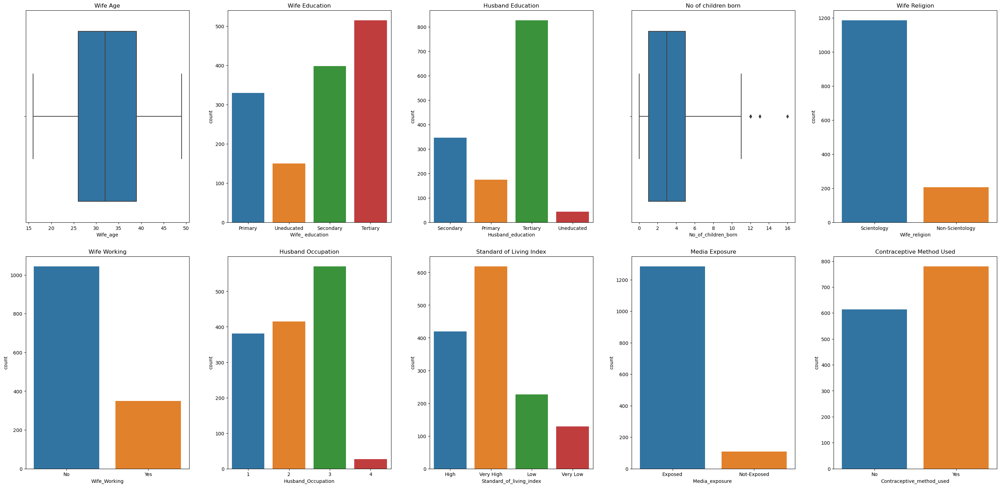

In [141]:
fig, ax = plt.subplots(2,5)
fig.set_size_inches(30,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=cont_df,x='Wife_age',ax=ax[0][0]).set(title='Wife Age')
sns.countplot(data=cont_df,x='Wife_ education',ax=ax[0][1]).set(title='Wife Education')
sns.countplot(data=cont_df,x='Husband_education',ax=ax[0][2]).set(title='Husband Education')
sns.boxplot(data=cont_df,x='No_of_children_born',ax=ax[0][3]).set(title='No of children born')
sns.countplot(data=cont_df,x='Wife_religion',ax=ax[0][4]).set(title='Wife Religion')
sns.countplot(data=cont_df,x='Wife_Working',ax=ax[1][0]).set(title='Wife Working')
sns.countplot(data=cont_df,x='Husband_Occupation',ax=ax[1][1]).set(title='Husband Occupation')
sns.countplot(data=cont_df,x='Standard_of_living_index',ax=ax[1][2]).set(title='Standard of Living Index')
sns.countplot(data=cont_df,x='Media_exposure ',ax=ax[1][3]).set(title='Media Exposure')
sns.countplot(data=cont_df,x='Contraceptive_method_used',ax=ax[1][4]).set(title='Contraceptive Method Used')


### Bivariate Analysis

[Text(0.5, 1.0, 'Media Exposure')]

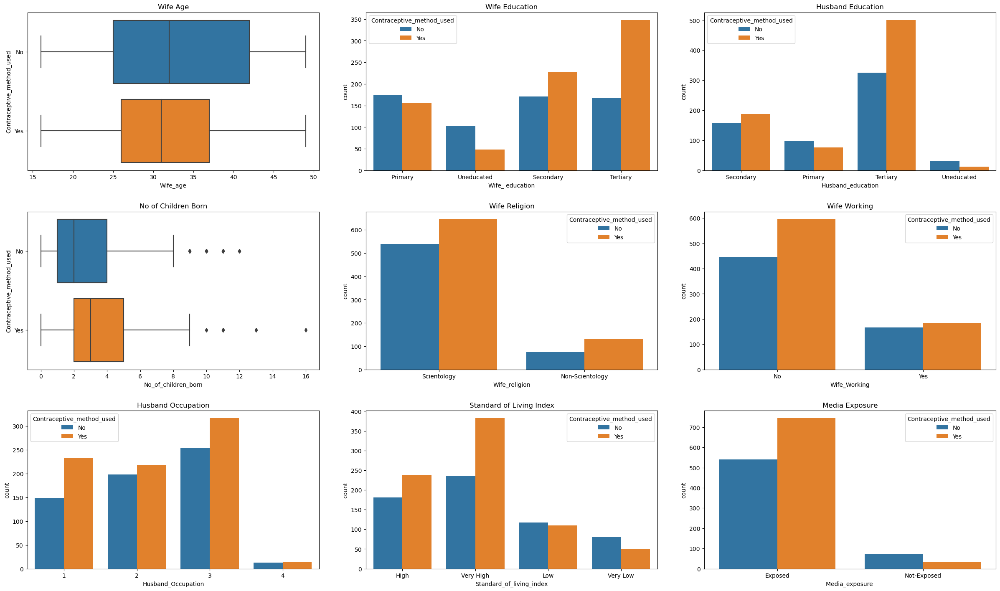

In [142]:
fig, ax = plt.subplots(3,3)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=cont_df,x='Wife_age',y='Contraceptive_method_used',ax=ax[0][0]).set(title='Wife Age')
sns.countplot(data=cont_df,x='Wife_ education',hue='Contraceptive_method_used',ax=ax[0][1]).set(title='Wife Education')
sns.countplot(data=cont_df,x='Husband_education',hue='Contraceptive_method_used',ax=ax[0][2]).set(title='Husband Education')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Contraceptive_method_used',ax=ax[1][0]).set(title='No of Children Born')
sns.countplot(data=cont_df,x='Wife_religion',hue='Contraceptive_method_used',ax=ax[1][1]).set(title='Wife Religion')
sns.countplot(data=cont_df,x='Wife_Working',hue='Contraceptive_method_used',ax=ax[1][2]).set(title='Wife Working')
sns.countplot(data=cont_df,x='Husband_Occupation',hue='Contraceptive_method_used',ax=ax[2][0]).set(title='Husband Occupation')
sns.countplot(data=cont_df,x='Standard_of_living_index',hue='Contraceptive_method_used',ax=ax[2][1]).set(title='Standard of Living Index')
sns.countplot(data=cont_df,x='Media_exposure ',hue='Contraceptive_method_used',ax=ax[2][2]).set(title='Media Exposure')



In [143]:
cont_df.groupby('Contraceptive_method_used')['Wife_age'].mean().round()

Contraceptive_method_used
No     33.0
Yes    32.0
Name: Wife_age, dtype: float64

In [144]:
cont_df.groupby('Contraceptive_method_used')['No_of_children_born'].median()

Contraceptive_method_used
No     2.0
Yes    3.0
Name: No_of_children_born, dtype: float64

In [145]:
cont_df.groupby('Wife_ education')[['Wife_ education','Contraceptive_method_used']].value_counts(normalize=True)

Wife_ education  Contraceptive_method_used
Primary          No                           0.527273
                 Yes                          0.472727
Secondary        Yes                          0.570352
                 No                           0.429648
Tertiary         Yes                          0.675728
                 No                           0.324272
Uneducated       No                           0.680000
                 Yes                          0.320000
dtype: float64

In [146]:
cont_df.groupby('Husband_education')[['Husband_education','Contraceptive_method_used']].value_counts(normalize=True)

Husband_education  Contraceptive_method_used
Primary            No                           0.560000
                   Yes                          0.440000
Secondary          Yes                          0.541787
                   No                           0.458213
Tertiary           Yes                          0.605804
                   No                           0.394196
Uneducated         No                           0.704545
                   Yes                          0.295455
dtype: float64

In [147]:
cont_df.groupby('Wife_religion')[['Wife_religion','Contraceptive_method_used']].value_counts(normalize=True)

Wife_religion    Contraceptive_method_used
Non-Scientology  Yes                          0.642512
                 No                           0.357488
Scientology      Yes                          0.544688
                 No                           0.455312
dtype: float64

In [148]:
cont_df.groupby('Wife_Working')[['Wife_Working','Contraceptive_method_used']].value_counts(normalize=True)

Wife_Working  Contraceptive_method_used
No            Yes                          0.571429
              No                           0.428571
Yes           Yes                          0.522857
              No                           0.477143
dtype: float64

In [149]:
cont_df.groupby('Husband_Occupation')[['Husband_Occupation','Contraceptive_method_used']].value_counts(normalize=True)

Husband_Occupation  Contraceptive_method_used
1                   Yes                          0.608924
                    No                           0.391076
2                   Yes                          0.522892
                    No                           0.477108
3                   Yes                          0.554386
                    No                           0.445614
4                   Yes                          0.518519
                    No                           0.481481
dtype: float64

In [150]:
cont_df.groupby('Standard_of_living_index')[['Standard_of_living_index','Contraceptive_method_used']].value_counts(normalize=True)

Standard_of_living_index  Contraceptive_method_used
High                      Yes                          0.568019
                          No                           0.431981
Low                       No                           0.515419
                          Yes                          0.484581
Very High                 Yes                          0.618123
                          No                           0.381877
Very Low                  No                           0.620155
                          Yes                          0.379845
dtype: float64

In [151]:
cont_df.groupby('Media_exposure ')[['Media_exposure ','Contraceptive_method_used']].value_counts(normalize=True)

Media_exposure   Contraceptive_method_used
Exposed          Yes                          0.579439
                 No                           0.420561
Not-Exposed      No                           0.678899
                 Yes                          0.321101
dtype: float64

[Text(0.5, 1.0, 'No_of_Ch vs med exp')]

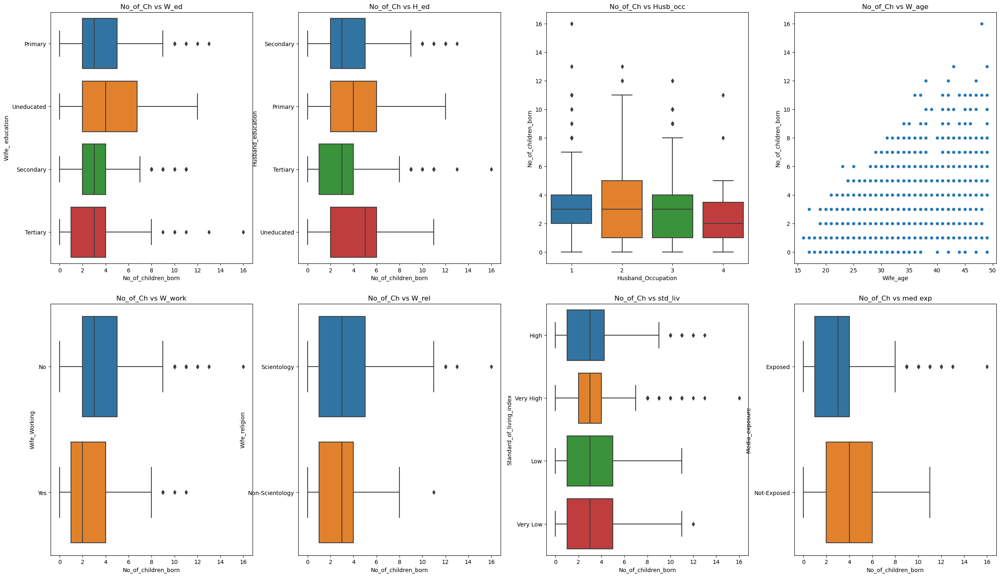

In [107]:
fig, ax = plt.subplots(2,4)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_ education',ax=ax[0][0]).set(title='No_of_Ch vs W_ed')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Husband_education',ax=ax[0][1]).set(title='No_of_Ch vs H_ed')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Husband_Occupation',ax=ax[0][2]).set(title='No_of_Ch vs Husb_occ')
sns.scatterplot(data=cont_df,x='Wife_age',y='No_of_children_born',ax=ax[0][3]).set(title='No_of_Ch vs W_age')

sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_Working',ax=ax[1][0]).set(title='No_of_Ch vs W_work')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_religion',ax=ax[1][1]).set(title='No_of_Ch vs W_rel')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Standard_of_living_index',ax=ax[1][2]).set(title='No_of_Ch vs std_liv')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Media_exposure ',ax=ax[1][3]).set(title='No_of_Ch vs med exp')



[Text(0.5, 1.0, 'No_of_Ch vs med exp')]

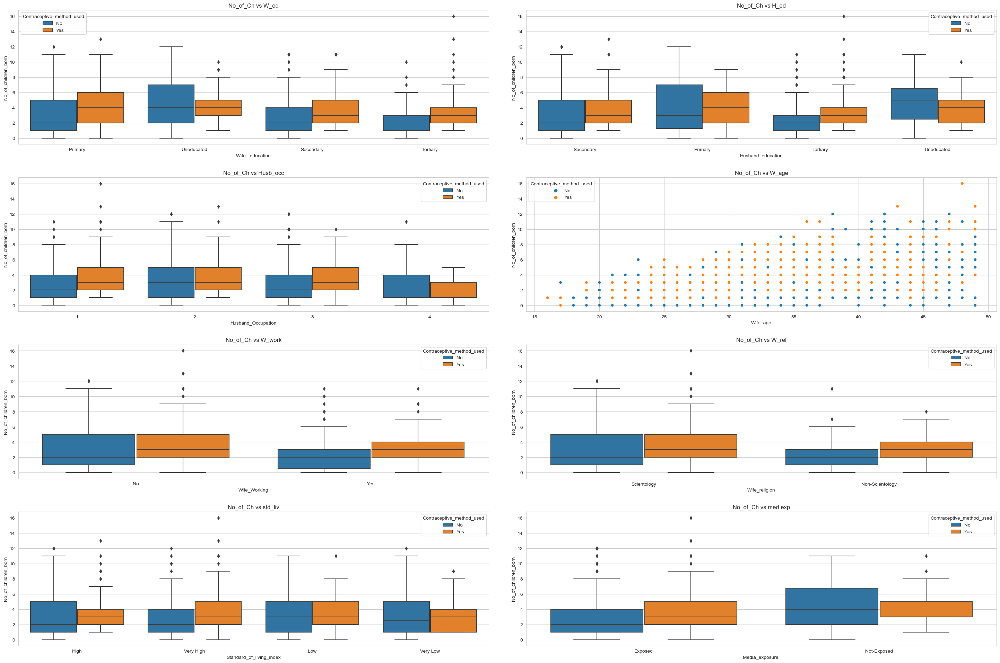

In [271]:

fig, ax = plt.subplots(4,2)
fig.set_size_inches(30,20)
fig.tight_layout(pad=5.0)
sns.boxplot(data=cont_df,y='No_of_children_born',x='Wife_ education',hue='Contraceptive_method_used',ax=ax[0][0]).set(title='No_of_Ch vs W_ed')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Husband_education',hue='Contraceptive_method_used',ax=ax[0][1]).set(title='No_of_Ch vs H_ed')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Husband_Occupation',hue='Contraceptive_method_used',ax=ax[1][0]).set(title='No_of_Ch vs Husb_occ')
sns.scatterplot(data=cont_df,x='Wife_age',y='No_of_children_born',hue='Contraceptive_method_used',ax=ax[1][1]).set(title='No_of_Ch vs W_age')

sns.boxplot(data=cont_df,y='No_of_children_born',x='Wife_Working',hue='Contraceptive_method_used',ax=ax[2][0]).set(title='No_of_Ch vs W_work')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Wife_religion',hue='Contraceptive_method_used',ax=ax[2][1]).set(title='No_of_Ch vs W_rel')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Standard_of_living_index',hue='Contraceptive_method_used',ax=ax[3][0]).set(title='No_of_Ch vs std_liv')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Media_exposure ',hue='Contraceptive_method_used',ax=ax[3][1]).set(title='No_of_Ch vs med exp')



In [283]:
cont_df.groupby(['Wife_ education','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Wife_ education  Contraceptive_method_used
Primary          No                           1.0
                 Yes                          3.0
Secondary        No                           1.0
                 Yes                          3.0
Tertiary         No                           1.0
                 Yes                          3.0
Uneducated       No                           4.0
                 Yes                          4.0
Name: No_of_children_born, dtype: float64

In [289]:
cont_df.groupby(['Husband_education','Contraceptive_method_used'])['No_of_children_born'].mean()

Husband_education  Contraceptive_method_used
Primary            No                           4.030612
                   Yes                          4.125000
Secondary          No                           3.270440
                   Yes                          3.818681
Tertiary           No                           2.352761
                   Yes                          3.350305
Uneducated         No                           4.548387
                   Yes                          4.230769
Name: No_of_children_born, dtype: float64

In [281]:
cont_df.groupby(['Husband_Occupation','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Husband_Occupation  Contraceptive_method_used
1                   No                           1.0
                    Yes                          2.0
2                   No                           1.0
                    Yes                          3.0
3                   No                           1.0
                    Yes                          3.0
4                   No                           1.0
                    Yes                          3.0
Name: No_of_children_born, dtype: float64

In [279]:
cont_df.groupby(['Wife_religion','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Wife_religion    Contraceptive_method_used
Non-Scientology  No                           1.0
                 Yes                          3.0
Scientology      No                           1.0
                 Yes                          3.0
Name: No_of_children_born, dtype: float64

In [291]:
cont_df.groupby(['Wife_Working','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Wife_Working  Contraceptive_method_used
No            No                           1.0
              Yes                          3.0
Yes           No                           0.0
              Yes                          2.0
Name: No_of_children_born, dtype: float64

In [292]:
cont_df.groupby(['Standard_of_living_index','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Standard_of_living_index  Contraceptive_method_used
High                      No                           1.0
                          Yes                          2.0
Low                       No                           2.0
                          Yes                          1.0
Very High                 No                           1.0
                          Yes                          3.0
Very Low                  No                           1.0
                          Yes                          1.0
Name: No_of_children_born, dtype: float64

In [293]:
cont_df.groupby(['Media_exposure ','Contraceptive_method_used'])['No_of_children_born'].agg(pd.Series.mode)

Media_exposure   Contraceptive_method_used
Exposed          No                           1.0
                 Yes                          3.0
Not-Exposed      No                           2.0
                 Yes                          3.0
Name: No_of_children_born, dtype: float64

In [112]:
cont_df.groupby('Wife_ education')['No_of_children_born'].agg(pd.Series.mode)

Wife_ education
Primary       1.0
Secondary     2.0
Tertiary      1.0
Uneducated    4.0
Name: No_of_children_born, dtype: float64

In [113]:
cont_df.groupby('Husband_education')['No_of_children_born'].agg(pd.Series.mode)

Husband_education
Primary       2.0
Secondary     1.0
Tertiary      2.0
Uneducated    5.0
Name: No_of_children_born, dtype: float64

In [114]:
cont_df.groupby('Husband_Occupation')['No_of_children_born'].agg(pd.Series.mode)

Husband_Occupation
1    2.0
2    1.0
3    2.0
4    1.0
Name: No_of_children_born, dtype: float64

In [115]:
cont_df.groupby('Wife_Working')['No_of_children_born'].agg(pd.Series.mode)

Wife_Working
No     2.0
Yes    1.0
Name: No_of_children_born, dtype: float64

In [116]:
cont_df.groupby('Wife_religion')['No_of_children_born'].agg(pd.Series.mode)

Wife_religion
Non-Scientology    3.0
Scientology        2.0
Name: No_of_children_born, dtype: float64

In [117]:
cont_df.groupby('Standard_of_living_index')['No_of_children_born'].agg(pd.Series.mode)

Standard_of_living_index
High         2.0
Low          1.0
Very High    3.0
Very Low     1.0
Name: No_of_children_born, dtype: float64

In [118]:
cont_df.groupby('Media_exposure ')['No_of_children_born'].agg(pd.Series.mode)

Media_exposure 
Exposed        1.0
Not-Exposed    3.0
Name: No_of_children_born, dtype: float64

In [119]:
cont_df.groupby('No_of_children_born')['Wife_age'].mean()

No_of_children_born
0.0     27.571429
1.0     27.200803
2.0     29.971429
3.0     32.296804
4.0     34.830409
5.0     36.553571
6.0     38.542169
7.0     39.617021
8.0     41.622222
9.0     41.285714
10.0    43.727273
11.0    43.545455
12.0    42.250000
13.0    46.000000
16.0    48.000000
Name: Wife_age, dtype: float64

In [153]:
cont_df.isnull().sum()

Wife_age                     67
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

In [685]:
cont_df['No_of_children_born'] = cont_df['No_of_children_born'].fillna(cont_df['No_of_children_born'].median())

In [686]:
cont_df['Wife_age'] = cont_df['Wife_age'].fillna(cont_df['Wife_age'].median())

In [156]:
cont_df.isnull().sum()

Wife_age                     0
Wife_ education              0
Husband_education            0
No_of_children_born          0
Wife_religion                0
Wife_Working                 0
Husband_Occupation           0
Standard_of_living_index     0
Media_exposure               0
Contraceptive_method_used    0
dtype: int64

In [687]:
def treat_outlier(x):
    # taking 25,75 percentile of column
    q25=np.percentile(x,25)
    q75=np.percentile(x,75)
    #calculationg IQR range
    IQR=q75-q25
    #Calculating minimum threshold
    lower_bound=q25-(1.5*IQR)
    upper_bound=q75+(1.5*IQR)
    #Capping outliers
    return x.apply(lambda y: upper_bound if y > upper_bound else y).apply(lambda y: lower_bound if y < lower_bound else y)

In [688]:
cont_df['No_of_children_born']=treat_outlier(cont_df['No_of_children_born'])

[Text(0.5, 1.0, 'No_of_Ch vs med exp')]

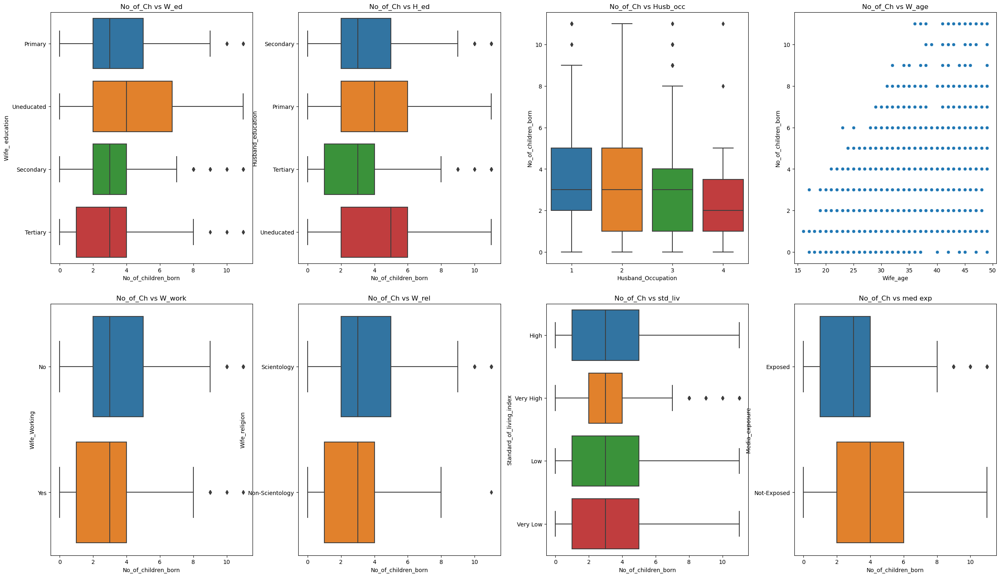

In [127]:
fig, ax = plt.subplots(2,4)
fig.set_size_inches(25,15)
fig.tight_layout(pad=5.0)
sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_ education',ax=ax[0][0]).set(title='No_of_Ch vs W_ed')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Husband_education',ax=ax[0][1]).set(title='No_of_Ch vs H_ed')
sns.boxplot(data=cont_df,y='No_of_children_born',x='Husband_Occupation',ax=ax[0][2]).set(title='No_of_Ch vs Husb_occ')
sns.scatterplot(data=cont_df,x='Wife_age',y='No_of_children_born',ax=ax[0][3]).set(title='No_of_Ch vs W_age')

sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_Working',ax=ax[1][0]).set(title='No_of_Ch vs W_work')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Wife_religion',ax=ax[1][1]).set(title='No_of_Ch vs W_rel')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Standard_of_living_index',ax=ax[1][2]).set(title='No_of_Ch vs std_liv')
sns.boxplot(data=cont_df,x='No_of_children_born',y='Media_exposure ',ax=ax[1][3]).set(title='No_of_Ch vs med exp')



In [689]:
cont_df['Wife_ education']=np.where(cont_df['Wife_ education'] =='Uneducated', 1, cont_df['Wife_ education'])
cont_df['Wife_ education']=np.where(cont_df['Wife_ education'] =='Primary', 2, cont_df['Wife_ education'])
cont_df['Wife_ education']=np.where(cont_df['Wife_ education'] =='Secondary', 3, cont_df['Wife_ education'])
cont_df['Wife_ education']=np.where(cont_df['Wife_ education'] =='Tertiary', 4, cont_df['Wife_ education'])

In [690]:
cont_df['Husband_education']=np.where(cont_df['Husband_education'] =='Uneducated', 1, cont_df['Husband_education'])
cont_df['Husband_education']=np.where(cont_df['Husband_education'] =='Primary', 2, cont_df['Husband_education'])
cont_df['Husband_education']=np.where(cont_df['Husband_education'] =='Secondary', 3, cont_df['Husband_education'])
cont_df['Husband_education']=np.where(cont_df['Husband_education'] =='Tertiary', 4, cont_df['Husband_education'])

In [691]:
cont_df['Standard_of_living_index']=np.where(cont_df['Standard_of_living_index'] =='Very High', 2, cont_df['Standard_of_living_index'])
cont_df['Standard_of_living_index']=np.where(cont_df['Standard_of_living_index'] =='High', 4, cont_df['Standard_of_living_index'])
cont_df['Standard_of_living_index']=np.where(cont_df['Standard_of_living_index'] =='Low', 3, cont_df['Standard_of_living_index'])
cont_df['Standard_of_living_index']=np.where(cont_df['Standard_of_living_index'] =='Very Low', 1, cont_df['Standard_of_living_index'])

In [692]:
cont_df['Media_exposure ']=np.where(cont_df['Media_exposure '] =='Not-Exposed', 0, cont_df['Media_exposure '])
cont_df['Media_exposure ']=np.where(cont_df['Media_exposure '] =='Exposed', 1, cont_df['Media_exposure '])

In [693]:
cont_df['Wife_ education']=cont_df['Wife_ education'].astype('int')

In [694]:
cont_df['Husband_education']=cont_df['Husband_education'].astype('int')

In [695]:
cont_df['Standard_of_living_index']=cont_df['Standard_of_living_index'].astype('int')

In [696]:
cont_df['Media_exposure ']=cont_df['Media_exposure '].astype('int')

In [699]:
cont_df['No_of_children_born']=cont_df['No_of_children_born'].astype('int')

In [697]:
for feature in cont_df.columns: 
    if cont_df[feature].dtype == 'object': 
        cont_df[feature] = pd.Categorical(cont_df[feature]).codes

In [564]:
cont_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Wife_age,1393.0,32.530510,8.088188,16.0,26.0,32.0,38.0,49.0
Wife_ education,1393.0,2.917444,1.015507,1.0,2.0,3.0,4.0,4.0
Husband_education,1393.0,3.404882,0.825965,1.0,3.0,4.0,4.0,4.0
No_of_children_born,1393.0,3.277100,2.345673,0.0,1.0,3.0,5.0,11.0
Wife_religion,1393.0,0.851400,0.355822,0.0,1.0,1.0,1.0,1.0
Wife_Working,1393.0,0.251256,0.433891,0.0,0.0,0.0,1.0,1.0
Husband_Occupation,1393.0,2.174444,0.854590,1.0,1.0,2.0,3.0,4.0
Standard_of_living_index,1393.0,2.671931,1.003969,1.0,2.0,2.0,4.0,4.0
Media_exposure,1393.0,0.921752,0.268658,0.0,1.0,1.0,1.0,1.0
Contraceptive_method_used,1393.0,0.559225,0.496658,0.0,0.0,1.0,1.0,1.0


In [700]:
cont_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1393 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1393 non-null   float64
 1   Wife_ education            1393 non-null   int32  
 2   Husband_education          1393 non-null   int32  
 3   No_of_children_born        1393 non-null   int32  
 4   Wife_religion              1393 non-null   int8   
 5   Wife_Working               1393 non-null   int8   
 6   Husband_Occupation         1393 non-null   int64  
 7   Standard_of_living_index   1393 non-null   int32  
 8   Media_exposure             1393 non-null   int32  
 9   Contraceptive_method_used  1393 non-null   int8   
dtypes: float64(1), int32(5), int64(1), int8(3)
memory usage: 63.9 KB


In [566]:
cont_df.head(10).T



,0,1,2,3,4,5,6,7,8,9
Wife_age,24.0,45.0,43.0,42.0,36.0,19.0,38.0,21.0,27.0,45.0
Wife_ education,2.0,1.0,2.0,3.0,3.0,4.0,2.0,3.0,2.0,1.0
Husband_education,3.0,3.0,3.0,2.0,3.0,4.0,3.0,3.0,3.0,1.0
No_of_children_born,3.0,10.0,7.0,9.0,8.0,0.0,6.0,1.0,3.0,8.0
Wife_religion,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
Wife_Working,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
Husband_Occupation,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,2.0
Standard_of_living_index,4.0,2.0,2.0,4.0,3.0,4.0,3.0,3.0,2.0,3.0
Media_exposure,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0
Contraceptive_method_used,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [155]:
cont_df[['Wife_ education']].value_counts()

Wife_ education
4                  515
3                  398
2                  330
1                  150
dtype: int64

In [156]:
cont_df[['Husband_education']].value_counts()

Husband_education
4                    827
3                    347
2                    175
1                     44
dtype: int64

In [157]:
cont_df[['Husband_Occupation']].value_counts()

Husband_Occupation
3                     570
2                     415
1                     381
4                      27
dtype: int64

In [158]:
cont_df[['Wife_religion']].value_counts()

Wife_religion
1                1186
0                 207
dtype: int64

In [159]:
cont_df[['Wife_Working']].value_counts()

Wife_Working
0               1043
1                350
dtype: int64

In [161]:
cont_df[['Standard_of_living_index']].value_counts()

Standard_of_living_index
2                           618
4                           419
3                           227
1                           129
dtype: int64

In [262]:
cont_df[['Media_exposure ']].value_counts()

Media_exposure 
1                  1284
0                   109
dtype: int64

In [404]:
cont_df[['Contraceptive_method_used']].value_counts()

Contraceptive_method_used
1                            779
0                            614
dtype: int64

## Logistic Regression

In [701]:
# Copy all the predictor variables into X dataframe
X = cont_df.drop('Contraceptive_method_used', axis=1)

# Copy target into the y dataframe. 
y = cont_df['Contraceptive_method_used']

In [702]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30 , random_state=1,stratify=y)

In [521]:
y_train.value_counts()

1    545
0    430
Name: Contraceptive_method_used, dtype: int64

In [522]:
y_train.value_counts(1)

1    0.558974
0    0.441026
Name: Contraceptive_method_used, dtype: float64

In [523]:
y_test.value_counts(1)

1    0.559809
0    0.440191
Name: Contraceptive_method_used, dtype: float64

In [703]:
model = LogisticRegression(max_iter=10000, n_jobs=2, penalty='l2', solver='newton-cg')
model.fit(X_train, y_train)
y_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)


In [704]:
print(model_score);
print(metrics.confusion_matrix(y_test, y_predict));
print(metrics.classification_report(y_test, y_predict));

0.6435406698564593
[[ 82 102]
 [ 47 187]]
              precision    recall  f1-score   support

           0       0.64      0.45      0.52       184
           1       0.65      0.80      0.72       234

    accuracy                           0.64       418
   macro avg       0.64      0.62      0.62       418
weighted avg       0.64      0.64      0.63       418



In [577]:
Actuals=pd.array(y_test)
Predictions=pd.array(y_predict)
Comparision={'Actual':Actuals,'Predictions':Predictions}
pd.DataFrame(Comparision)

,Actual,Predictions
0,0,1
1,0,0
2,0,1
3,1,1
4,0,1
...,...,...
413,1,1
414,0,1
415,0,1
416,1,0


In [705]:

y_predict_train = model.predict(X_train)
model_score_train = model.score(X_train, y_train)
print(model_score_train)
print(metrics.confusion_matrix(y_train, y_predict_train))
print(metrics.classification_report(y_train, y_predict_train))

0.6615384615384615
[[215 215]
 [115 430]]
              precision    recall  f1-score   support

           0       0.65      0.50      0.57       430
           1       0.67      0.79      0.72       545

    accuracy                           0.66       975
   macro avg       0.66      0.64      0.64       975
weighted avg       0.66      0.66      0.65       975



In [578]:
Actuals=pd.array(y_train)
Predictions=pd.array(y_predict_train)
Comparision={'Actual':Actuals,'Predictions':Predictions}
pd.DataFrame(Comparision)

,Actual,Predictions
0,0,0
1,1,1
2,1,1
3,1,1
4,0,0
...,...,...
970,0,0
971,0,0
972,0,1
973,1,1


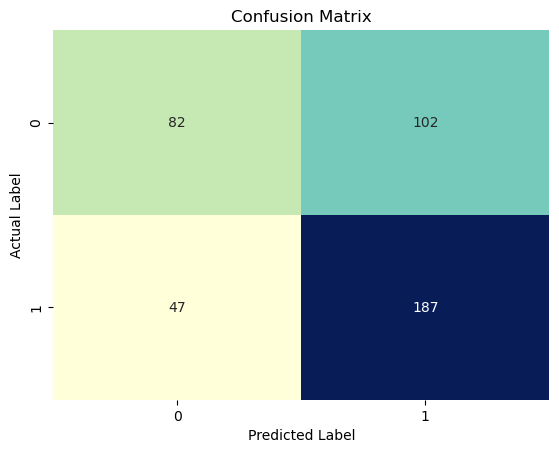

In [706]:
sns.heatmap(confusion_matrix(y_test,y_predict),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

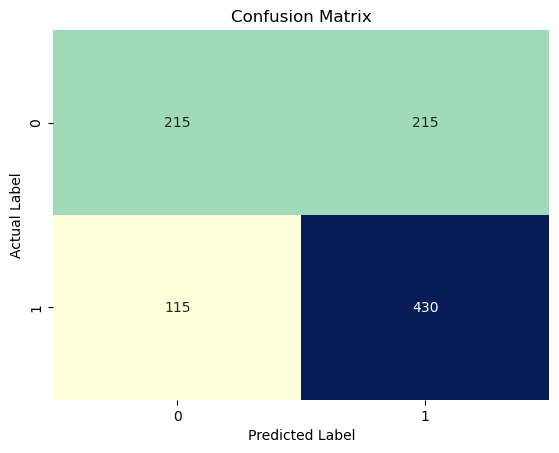

In [712]:
sns.heatmap(confusion_matrix(y_train,y_predict_train),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [713]:
ytest_predict_prob=model.predict_proba(X_test)
pd.DataFrame(ytest_predict_prob).head()

,0,1
0,0.287798,0.712202
1,0.583059,0.416941
2,0.375706,0.624294
3,0.307124,0.692876
4,0.260349,0.739651


AUC: 0.712


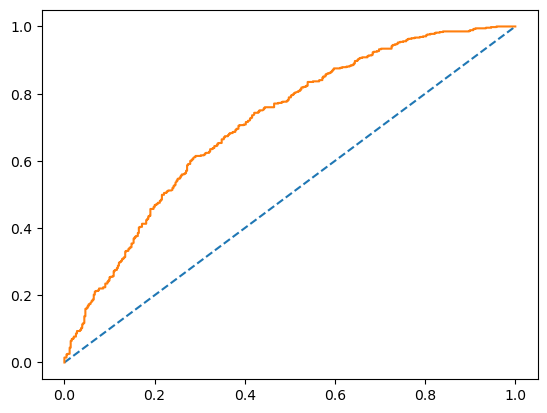

In [714]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
train_fpr, train_tpr, train_thresholds = roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(train_fpr, train_tpr);

AUC: 0.674


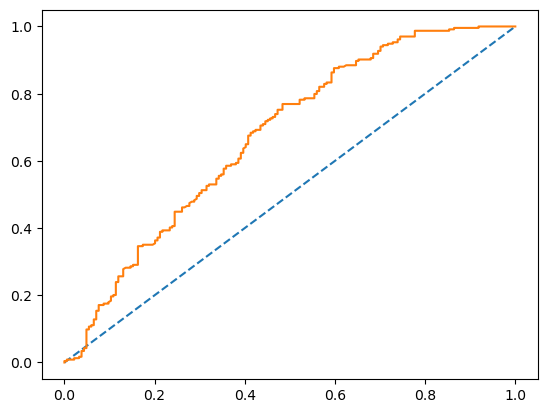

In [715]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
test_auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % test_auc)
# calculate roc curve
test_fpr, test_tpr, test_thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(test_fpr, test_tpr);

In [716]:
grid={'penalty':['l2','none'],
      'solver':['sag','lbfgs','newton-cg'],
      'tol':[0.0001,0.00001]}

In [717]:
model = LogisticRegression(max_iter=10000,n_jobs=2)

In [718]:
grid_search = GridSearchCV(estimator = model, param_grid = grid, cv = 3,n_jobs=-1,scoring='f1')

In [719]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=LogisticRegression(max_iter=10000, n_jobs=2),
             n_jobs=-1,
             param_grid={'penalty': ['l2', 'none'],
                         'solver': ['sag', 'lbfgs', 'newton-cg'],
                         'tol': [0.0001, 1e-05]},
             scoring='f1')

In [720]:
print(grid_search.best_params_,'\n')
print(grid_search.best_estimator_)

{'penalty': 'none', 'solver': 'lbfgs', 'tol': 0.0001} 

LogisticRegression(max_iter=10000, n_jobs=2, penalty='none')


In [721]:
best_model = grid_search.best_estimator_

In [722]:
ytrain_predict = best_model.predict(X_train)
ytest_predict = best_model.predict(X_test)

In [723]:
ytest_predict_prob=best_model.predict_proba(X_test)
pd.DataFrame(ytest_predict_prob).head()

,0,1
0,0.288235,0.711765
1,0.582494,0.417506
2,0.374834,0.625166
3,0.304237,0.695763
4,0.256933,0.743067


In [724]:
y_predict_train = best_model.predict(X_train)
best_model_score_train = best_model.score(X_train, y_train)
print(best_model_score_train)
print(metrics.confusion_matrix(y_train, y_predict_train))
print(metrics.classification_report(y_train, y_predict_train))

0.6635897435897435
[[216 214]
 [114 431]]
              precision    recall  f1-score   support

           0       0.65      0.50      0.57       430
           1       0.67      0.79      0.72       545

    accuracy                           0.66       975
   macro avg       0.66      0.65      0.65       975
weighted avg       0.66      0.66      0.66       975



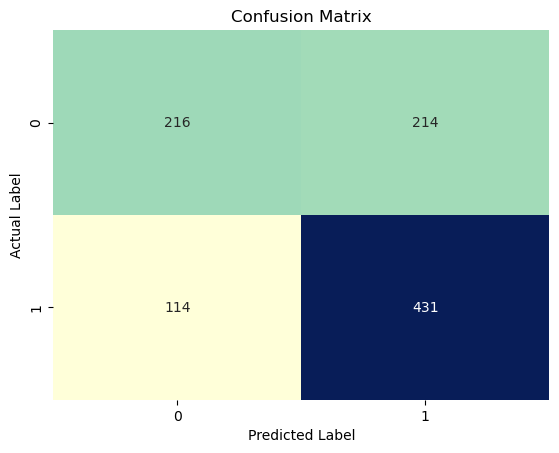

In [726]:
sns.heatmap(confusion_matrix(y_train,y_predict_train),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [727]:
y_predict_test = best_model.predict(X_test)
best_model_score_test = best_model.score(X_test, y_test)
print(best_model_score_test)
print(metrics.confusion_matrix(y_test, y_predict_test))
print(metrics.classification_report(y_test, y_predict_test))

0.6411483253588517
[[ 81 103]
 [ 47 187]]
              precision    recall  f1-score   support

           0       0.63      0.44      0.52       184
           1       0.64      0.80      0.71       234

    accuracy                           0.64       418
   macro avg       0.64      0.62      0.62       418
weighted avg       0.64      0.64      0.63       418



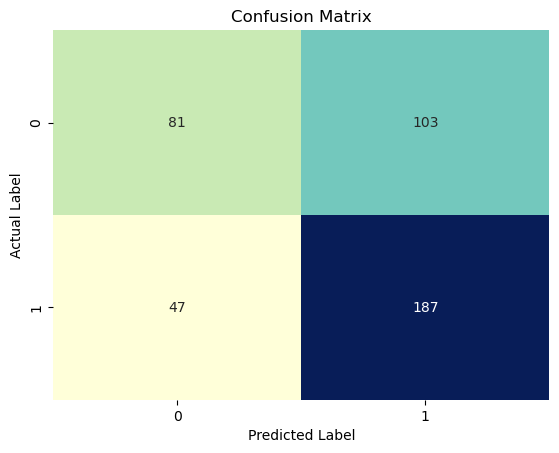

In [728]:
sns.heatmap(confusion_matrix(y_test,y_predict_test),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

Inferences :
For predicting Contrceptive_used (Label 1 ):

Precision (64%) – 64% of Women predicted are actually using contraceptive out of all employees predicted to use contraceptive.

Recall (79%) – Out of all the Women who  actually use contraceptive, 79% of women have been predicted correctly to use contraceptive.

For predicting Contrceptive_not used (Label 0 ):

Precision (62%) – 62% of Women predicted are actually not using contraceptive out of all employees predicted to not use contraceptive.

Recall (43%) – Out of all the Women who  actually do not use contraceptive, 43% of women have been predicted correctly to not use contraceptive.


Overall accuracy of the model – 63 % of total predictions are correct
Accuracy, AUC, Precision and Recall for test data is almost inline with training data. This proves no overfitting or underfitting has happened, and overall the model is a not a very good model for classification

In [729]:
print(s3," rows classified as 1 (Contrceptive used) ")
print(s4," rows classified as 0 (Contrceptive not used) ")

936  rows classified as 1 (Contrceptive used) 
457  rows classified as 0 (Contrceptive not used) 


In [819]:
cont_df.columns

Index(['Wife_age', 'Wife_ education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure ',
       'Contraceptive_method_used'],
      dtype='object')

### LDA

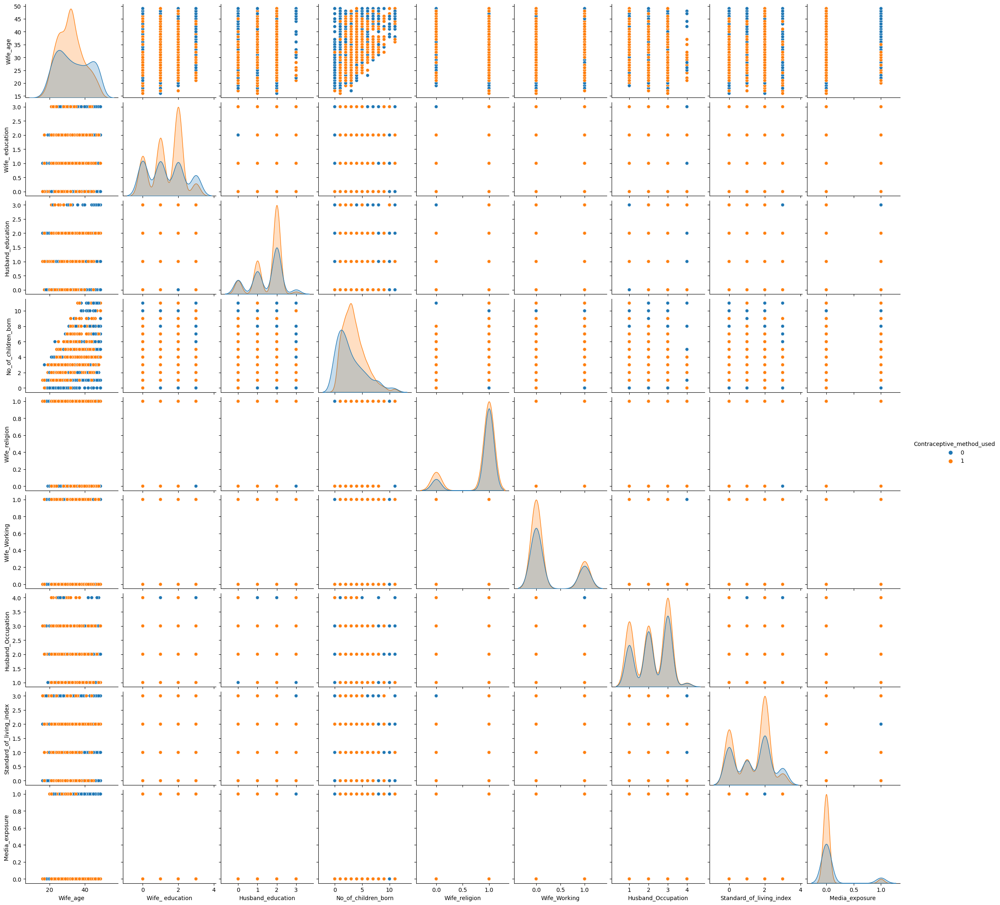

In [27]:
sns.pairplot(cont_df,hue='Contraceptive_method_used')

In [824]:
cont_df_subset1=cont_df[['Wife_age','No_of_children_born','Contraceptive_method_used']]

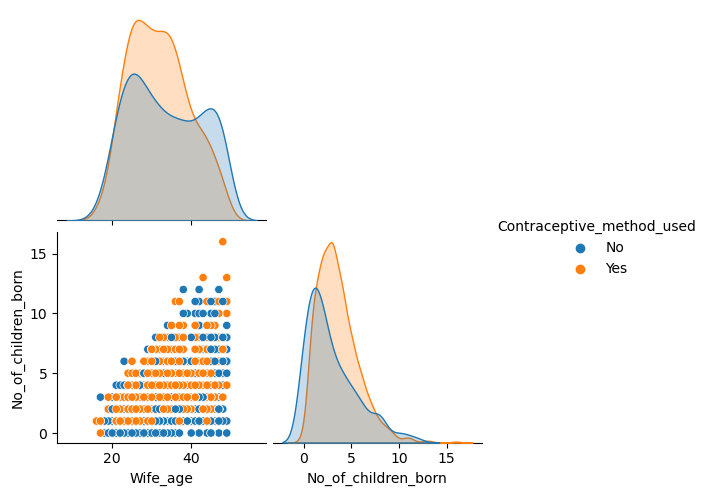

In [826]:
sns.pairplot(cont_df_subset1,hue='Contraceptive_method_used',corner=True)

As we can see from the above plot the variables wife age and no of childern born  show  the separation between 2 classes to soem extent , whereas other variables the plots are overlapping

In [579]:
X1 = cont_df.drop('Contraceptive_method_used', axis=1)

# Copy target into the y dataframe. 
y1 = cont_df['Contraceptive_method_used']

In [580]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.30 , random_state=1,stratify=y)

In [ ]:
clf = LinearDiscriminantAnalysis()
model1=clf.fit(X_train1, y_train1)


In [581]:
y_predict1 = model1.predict(X_test1)
confusion_matrix(y_test1, y_predict1)

array([[ 81, 103],
       [ 43, 191]], dtype=int64)

In [582]:
y_predict_train1 = model1.predict(X_train1)
confusion_matrix(y_train1, y_predict_train1)


array([[211, 219],
       [110, 435]], dtype=int64)

In [446]:
from sklearn.metrics import classification_report
print(classification_report(y_test1, y_predict1))

              precision    recall  f1-score   support

           0       0.65      0.44      0.53       184
           1       0.65      0.82      0.72       234

    accuracy                           0.65       418
   macro avg       0.65      0.63      0.62       418
weighted avg       0.65      0.65      0.64       418



In [447]:
from sklearn.metrics import classification_report
print(classification_report(y_train1, y_predict_train1))

              precision    recall  f1-score   support

           0       0.66      0.49      0.56       430
           1       0.67      0.80      0.73       545

    accuracy                           0.66       975
   macro avg       0.66      0.64      0.64       975
weighted avg       0.66      0.66      0.65       975



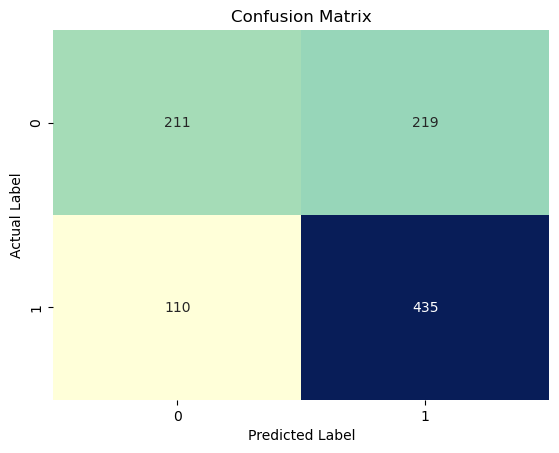

In [448]:
sns.heatmap(confusion_matrix(y_train1,y_predict_train1),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

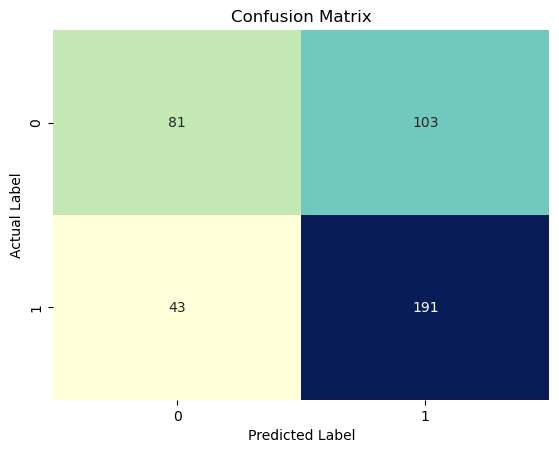

In [449]:
sns.heatmap(confusion_matrix(y_test1,y_predict1),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [450]:
model1.coef_

array([[-0.06732334,  0.54684355,  0.11521417,  0.31966728, -0.52130767,
        -0.11443342,  0.10297826, -0.03507941,  0.53364837]])

In [451]:
model1.intercept_

array([-0.71555201])

In [452]:


DS=[]
intercept=-0.71555201
coef= [-0.06732334,  0.54684355,  0.11521417,  0.31966728, -0.52130767,
        -0.11443342,  0.10297826, -0.03507941,  0.53364837]# Coefficients 
for p in range(len(X)):
    s3=0
    for q in range(X.shape[1]):
        s3=s3+(X.iloc[p,q]*coef[q]) # Building the LDF equation 
    s3=s3+intercept
    DS.append(s3)
    

In [453]:
'''
Classification Rule :

if LDF>=0 then Classify as 1 
else if LDF <0 then Classify as 0 
'''


s1=0
s2=0
for i in range(len(X)):
    if DS[i]>=0:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ DS: ",DS[i],">=0 , Classify as 1}")
        print("------------------------------------------------------------------------------------------")
        s1+=1
    elif DS[i]<0:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ DS: ",DS[i],"<0 , Classify as 0}")
        print("------------------------------------------------------------------------------------------")
        s2+=1



FOR Row: 0   Wife_age                    24.0
Wife_ education              2.0
Husband_education            3.0
No_of_children_born          3.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           2.0
Standard_of_living_index     4.0
Media_exposure               1.0
Name: 0, dtype: float64

--> { DS:  0.14499886000000006 >=0 , Classify as 1}
------------------------------------------------------------------------------------------
FOR Row: 1   Wife_age                    45.0
Wife_ education              1.0
Husband_education            3.0
No_of_children_born         10.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           3.0
Standard_of_living_index     2.0
Media_exposure               1.0
Name: 1, dtype: float64

--> { DS:  0.5951732100000001 >=0 , Classify as 1}
------------------------------------------------------------------------------------------
FOR Row: 2   Wife_age                    43.0

In [454]:
print(s1," rows classified as 1 (Not Default) ")
print(s2," rows classified as 0 (Default) ")

948  rows classified as 1 (Not Default) 
445  rows classified as 0 (Default) 


In [455]:
pred_prob=model1.predict_proba(X)#Posterior Probability for each row

In [456]:
pred_prob[:,1]

array([0.53618631, 0.64455119, 0.57875421, ..., 0.38573858, 0.50164454,
       0.64426636])

In [457]:
'''
Classification Rule :

if prob(Y=1|X) >=0 then Classify as 1 
else ifprob(Y=1|X) <0 then Classify as 0 
'''


s3,s4=0,0
for i in range(len(pred_prob[:,1])):
    if pred_prob[:,1][i]>=0.5:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ prob(Y=1|X) =",pred_prob[:,1][i],">=0.5 , Classify as 1 }")
        print("------------------------------------------------------------------------------------------")
        s3+=1
    elif pred_prob[:,1][i]<0.5:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ prob(Y=1|X) =",pred_prob[:,1][i],"< 0.5 , Classify as 0 }")
        print("------------------------------------------------------------------------------------------")
        s4+=1

  

FOR Row: 0   Wife_age                    24.0
Wife_ education              2.0
Husband_education            3.0
No_of_children_born          3.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           2.0
Standard_of_living_index     4.0
Media_exposure               1.0
Name: 0, dtype: float64

--> { prob(Y=1|X) = 0.536186310734944 >=0.5 , Classify as 1 }
------------------------------------------------------------------------------------------
FOR Row: 1   Wife_age                    45.0
Wife_ education              1.0
Husband_education            3.0
No_of_children_born         10.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           3.0
Standard_of_living_index     2.0
Media_exposure               1.0
Name: 1, dtype: float64

--> { prob(Y=1|X) = 0.6445511899507037 >=0.5 , Classify as 1 }
------------------------------------------------------------------------------------------
FOR Row: 2   Wife_age  

In [458]:
print(s3," rows classified as 1 (Not Default) ")
print(s4," rows classified as 0 (Default) ")

948  rows classified as 1 (Not Default) 
445  rows classified as 0 (Default) 


AUC for Training Data: 0.712


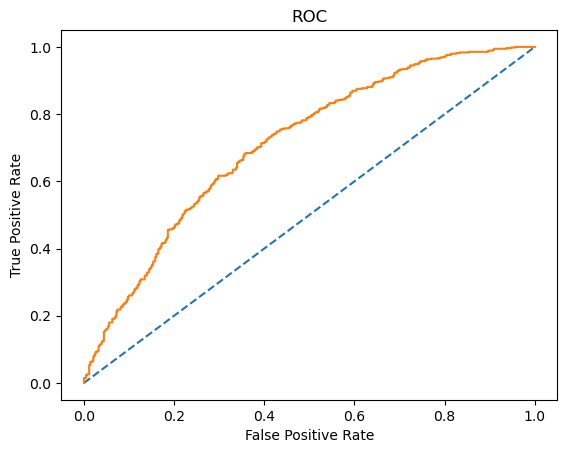

In [459]:
# predict probabilities
probs_tr = model1.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs_tr = probs_tr[:, 1]
# calculate AUC
train_auc = roc_auc_score(y_train1, probs_tr)

print('AUC for Training Data: %.3f' % (train_auc))
# calculate roc curve
test_fpr_tr, test_tpr_tr, test_thresholds_tr = roc_curve(y_train1, probs_tr)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model

plt.plot(test_fpr_tr, test_tpr_tr);
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()


AUC for Test Data: 0.674


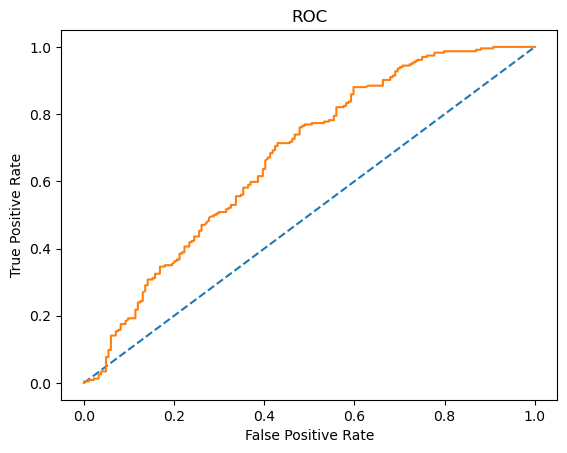

In [460]:
# predict probabilities
probs = model1.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
test_auc = roc_auc_score(y_test1, probs)

print('AUC for Test Data: %.3f' %(test_auc))
# calculate roc curve
test_fpr, test_tpr, test_thresholds = roc_curve(y_test1, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(test_fpr, test_tpr);
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()

## CART

In [763]:
from sklearn.tree import DecisionTreeClassifier

In [764]:
X2 = cont_df.drop('Contraceptive_method_used', axis=1)

# Copy target into the y dataframe. 
y2 = cont_df['Contraceptive_method_used']

In [765]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=.30, random_state=1,stratify=y)

In [766]:
cart_model = DecisionTreeClassifier(criterion = 'gini' ,random_state=1)

In [767]:
cart_model.fit(X_train2, y_train2)

DecisionTreeClassifier(random_state=1)

In [735]:
from sklearn import tree

train_char_label = ['No', 'Yes']
Credit_Tree_File = open('d:\credit_tree.dot','w')
dot_data = tree.export_graphviz(cart_model, out_file=Credit_Tree_File, feature_names = list(X_train2), class_names = list(train_char_label))

Credit_Tree_File.close()

In [736]:
print (pd.DataFrame(cart_model.feature_importances_, columns = ["Imp"], index = X_train2.columns).sort_values(by="Imp",ascending=False))

                               Imp
Wife_age                  0.354900
No_of_children_born       0.247357
Wife_ education           0.088884
Standard_of_living_index  0.081164
Husband_education         0.079011
Husband_Occupation        0.061383
Wife_Working              0.044006
Wife_religion             0.030009
Media_exposure            0.013285


In [768]:
y_test_predict = cart_model.predict(X_test2)

In [769]:
y_predict_train = cart_model.predict(X_train2)

In [770]:
print(classification_report(y_test2,y_test_predict))

              precision    recall  f1-score   support

           0       0.51      0.52      0.52       184
           1       0.62      0.61      0.61       234

    accuracy                           0.57       418
   macro avg       0.56      0.56      0.56       418
weighted avg       0.57      0.57      0.57       418



In [771]:
print(classification_report(y_train2,y_predict_train))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       430
           1       1.00      0.98      0.99       545

    accuracy                           0.99       975
   macro avg       0.99      0.99      0.99       975
weighted avg       0.99      0.99      0.99       975



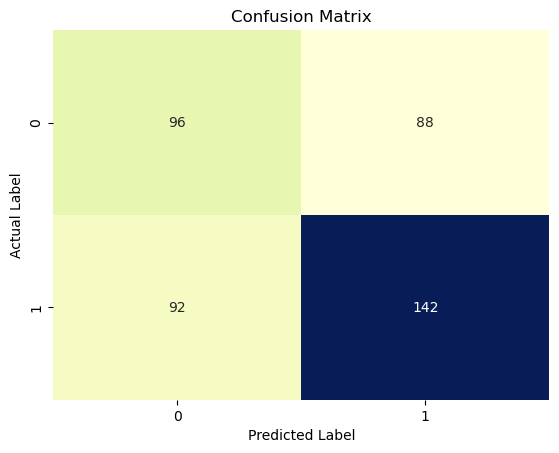

In [774]:
sns.heatmap(confusion_matrix(y_test2,y_test_predict),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

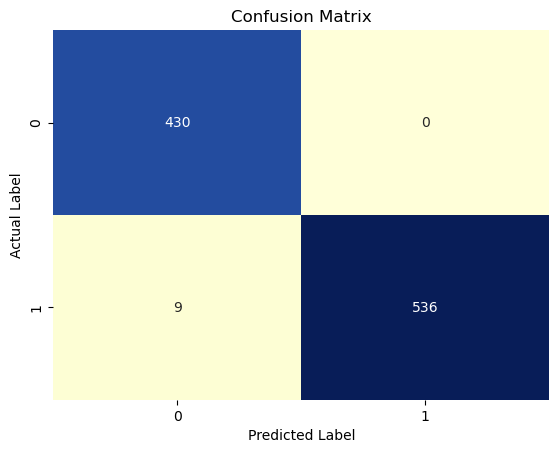

In [773]:
sns.heatmap(confusion_matrix(y_train2,y_predict_train),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [742]:
reg_dt_model_1 = DecisionTreeClassifier(criterion = 'gini', max_depth = 10,min_samples_leaf=20,min_samples_split=50,random_state=1,)
reg_dt_model_1.fit(X_train2, y_train2)

DecisionTreeClassifier(max_depth=10, min_samples_leaf=20, min_samples_split=50,
                       random_state=1)

In [743]:
y_test_predict1 = reg_dt_model_1.predict(X_test2)

In [744]:
y_train_predict1 = reg_dt_model_1.predict(X_train2)

In [745]:
credit_tree_regularized = open('d:\credit_tree_regularized.dot','w')
dot_data = tree.export_graphviz(reg_dt_model_1, out_file= credit_tree_regularized , feature_names = list(X_train2), class_names = list(train_char_label))

credit_tree_regularized.close()

print (pd.DataFrame(reg_dt_model_1.feature_importances_, columns = ["Imp"], index = X_train2.columns).sort_values(by="Imp",ascending=False))

                               Imp
No_of_children_born       0.434211
Wife_age                  0.258082
Wife_ education           0.182001
Standard_of_living_index  0.063380
Husband_education         0.052572
Husband_Occupation        0.008180
Wife_Working              0.001574
Wife_religion             0.000000
Media_exposure            0.000000


In [746]:
print(classification_report(y_test2,y_test_predict1))

              precision    recall  f1-score   support

           0       0.68      0.51      0.58       184
           1       0.68      0.82      0.74       234

    accuracy                           0.68       418
   macro avg       0.68      0.66      0.66       418
weighted avg       0.68      0.68      0.67       418



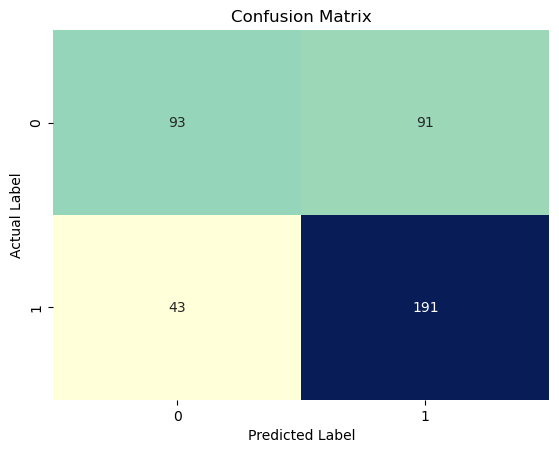

In [747]:
sns.heatmap(confusion_matrix(y_test2,y_test_predict1),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [748]:
print(classification_report(y_train2,y_train_predict1))

              precision    recall  f1-score   support

           0       0.78      0.58      0.67       430
           1       0.72      0.87      0.79       545

    accuracy                           0.74       975
   macro avg       0.75      0.73      0.73       975
weighted avg       0.75      0.74      0.74       975



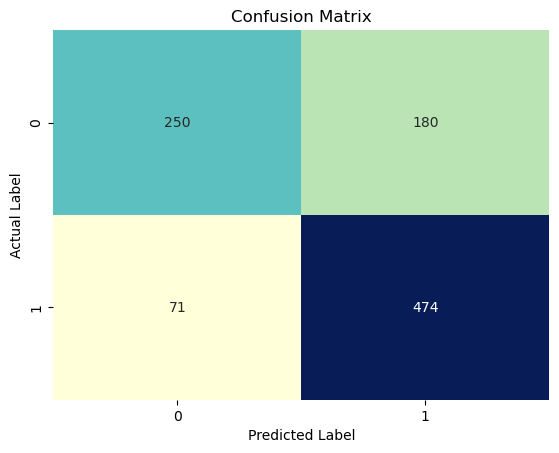

In [749]:
sns.heatmap(confusion_matrix(y_train2,y_train_predict1),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [750]:
reg_dt_model_2 = DecisionTreeClassifier(criterion = 'gini', max_depth = 7,min_samples_leaf=20,min_samples_split=50,random_state=1,)
reg_dt_model_2.fit(X_train2, y_train2)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=20, min_samples_split=50,
                       random_state=1)

In [751]:
y_test_predict2 = reg_dt_model_2.predict(X_test2)

In [752]:
y_train_predict2 = reg_dt_model_2.predict(X_train2)

In [761]:
credit_tree_regularized2 = open('d:\credit_tree_regularized2.dot','w')
dot_data = tree.export_graphviz(reg_dt_model_2, out_file= credit_tree_regularized2 , feature_names = list(X_train2), class_names = list(train_char_label))

credit_tree_regularized2.close()

print (pd.DataFrame(reg_dt_model_2.feature_importances_, columns = ["Imp"], index = X_train2.columns).sort_values(by="Imp",ascending=False))

                               Imp
No_of_children_born       0.451512
Wife_age                  0.268365
Wife_ education           0.186147
Husband_education         0.054667
Standard_of_living_index  0.037672
Wife_Working              0.001637
Wife_religion             0.000000
Husband_Occupation        0.000000
Media_exposure            0.000000


C:\Users\Dell\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


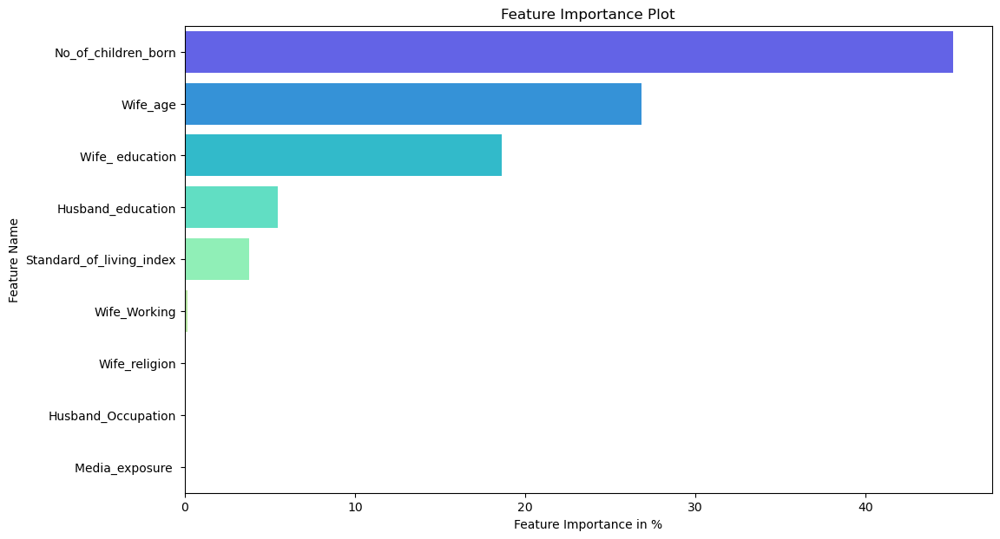

In [755]:
x=pd.DataFrame(reg_dt_model_2.feature_importances_*100,index=X_train2.columns).sort_values(by=0,ascending=False)
plt.figure(figsize=(12,7))
sns.barplot(x[0],x.index,palette='rainbow')
plt.ylabel('Feature Name')
plt.xlabel('Feature Importance in %')
plt.title('Feature Importance Plot')
plt.show()


In [756]:
print(classification_report(y_test2,y_test_predict2))

              precision    recall  f1-score   support

           0       0.68      0.51      0.58       184
           1       0.68      0.82      0.74       234

    accuracy                           0.68       418
   macro avg       0.68      0.66      0.66       418
weighted avg       0.68      0.68      0.67       418



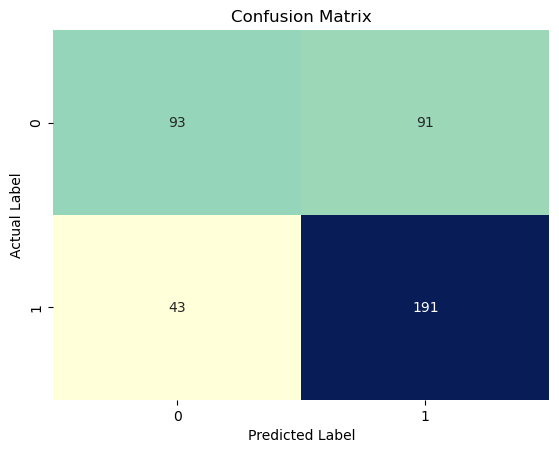

In [757]:
sns.heatmap(confusion_matrix(y_test2,y_test_predict2),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()


In [758]:
print(classification_report(y_train2,y_train_predict2))

              precision    recall  f1-score   support

           0       0.78      0.58      0.67       430
           1       0.72      0.87      0.79       545

    accuracy                           0.74       975
   macro avg       0.75      0.73      0.73       975
weighted avg       0.75      0.74      0.74       975



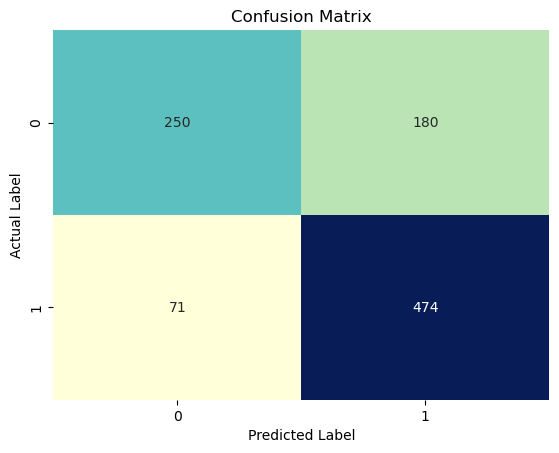

In [759]:
sns.heatmap(confusion_matrix(y_train2,y_train_predict2),annot=True, fmt='d', cbar=False,cmap='YlGnBu')
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()


In [760]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,roc_auc_score,roc_curve

In [622]:
print('Accuracy Score is',round(accuracy_score(y_test2, y_test_predict1),3)*100,'%')

Accuracy Score is 67.9 %


In [623]:
print('Area Under the Curve is',round(roc_auc_score(y_test2,reg_dt_model.predict_proba(X_test2)[:,1]),3)*100,'%')

Area Under the Curve is 70.3 %


In [624]:
dt_fpr, dt_tpr,_=roc_curve(y_test2,reg_dt_model.predict_proba(X_test2)[:,1])

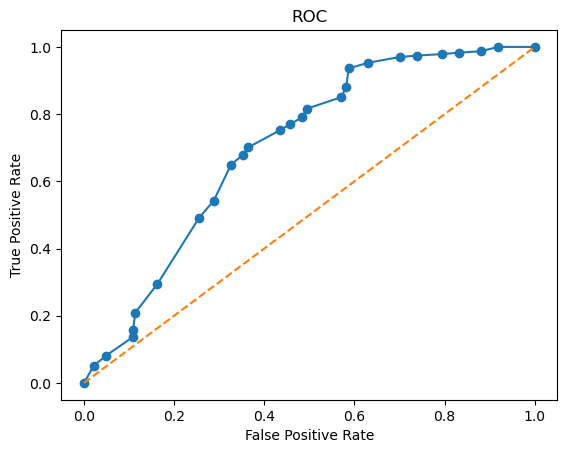

In [625]:
plt.plot(dt_fpr,dt_tpr, marker='o', label='Decision Tree')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()




In [626]:
print('Area Under the Curve is',round(roc_auc_score(y_train2,reg_dt_model.predict_proba(X_train2)[:,1]),3)*100,'%')

Area Under the Curve is 81.69999999999999 %


In [627]:
dt_fpr, dt_tpr,_=roc_curve(y_train2,reg_dt_model.predict_proba(X_train2)[:,1])

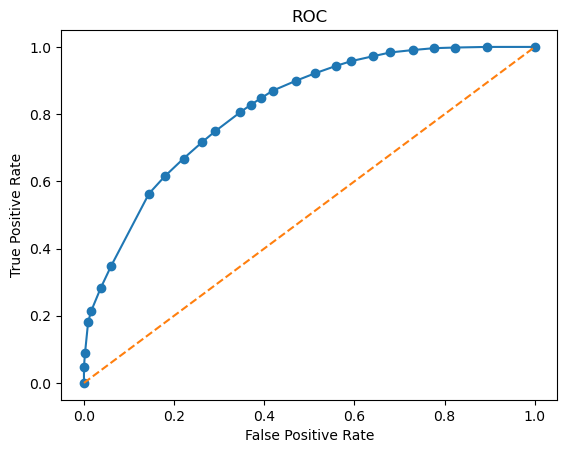

In [628]:
plt.plot(dt_fpr,dt_tpr, marker='o', label='Decision Tree')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC')
plt.show()


In [515]:
pred_prob=reg_dt_model.predict_proba(X)#Posterior Probability for each row

In [516]:

pred_prob[:,1]

array([0.52173913, 0.13043478, 0.56363636, ..., 0.56363636, 0.76470588,
       0.6       ])

In [517]:
'''
Classification Rule :

if prob(Y=1|X) >=0 then Classify as 1 
else ifprob(Y=1|X) <0 then Classify as 0 
'''


s3,s4=0,0
for i in range(len(pred_prob[:,1])):
    if pred_prob[:,1][i]>=0.5:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ prob(Y=1|X) =",pred_prob[:,1][i],">=0.5 , Classify as 1 }")
        print("------------------------------------------------------------------------------------------")
        s3+=1
    elif pred_prob[:,1][i]<0.5:
        print("FOR Row:",i," ",X.iloc[i,:])
        print()
        print("-->","{ prob(Y=1|X) =",pred_prob[:,1][i],"< 0.5 , Classify as 0 }")
        print("------------------------------------------------------------------------------------------")
        s4+=1


FOR Row: 0   Wife_age                    24.0
Wife_ education              2.0
Husband_education            3.0
No_of_children_born          3.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           2.0
Standard_of_living_index     4.0
Media_exposure               1.0
Name: 0, dtype: float64

--> { prob(Y=1|X) = 0.5217391304347826 >=0.5 , Classify as 1 }
------------------------------------------------------------------------------------------
FOR Row: 1   Wife_age                    45.0
Wife_ education              1.0
Husband_education            3.0
No_of_children_born         10.0
Wife_religion                1.0
Wife_Working                 0.0
Husband_Occupation           3.0
Standard_of_living_index     2.0
Media_exposure               1.0
Name: 1, dtype: float64

--> { prob(Y=1|X) = 0.13043478260869565 < 0.5 , Classify as 0 }
------------------------------------------------------------------------------------------
FOR Row: 2   Wife_age

In [518]:
print(s3," rows classified as 1 (Not Default) ")
print(s4," rows classified as 0 (Default) ")

936  rows classified as 1 (Not Default) 
457  rows classified as 0 (Default) 
